# Dependencies

In [1]:
import os
import sys
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from glob import glob
from torchsummary import summary

if torch.cuda.is_available():
    print("Using GPU")
    torch.device("cuda")

%load_ext autoreload
%autoreload 2

In [2]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)
%cd /content/drive/MyDrive/CV/nyu_computer_vision_project

Mounted at /content/drive
/content/drive/MyDrive/CV/nyu_computer_vision_project


In [3]:
sys.path.append('/content/drive/MyDrive/CV/nyu_computer_vision_project/supres/')
from common.loss import VGGPerceptualLoss
from runet.runet import RUNet
from runet.train import train

# Environment

In [4]:
DATA_ROOT = '/content/drive/MyDrive/CTScan_dataset/data' #chest CT dataset location

scale_factor=0.2 #scale factor for reducing image resolution
lr=0.001
n_epochs=2
batch_size=16

orig_size = (630, 626)
input_size =256 #TODO: solve the memory issue to make it work with 512 size

# Input preprocessing

In [87]:
#quick image stat calc
input_paths = []
classes = ['Adenocarcinoma', 'Large cell carcinoma', 'Squamous cell carcinoma', 'Normal']
for path in [os.path.join(DATA_ROOT, 'train'), os.path.join(DATA_ROOT, 'test')]:
  # Load all images from each class
  for cls in classes:
      class_path = os.path.join(path, cls)
      input_paths.extend(glob(os.path.join(class_path, '*')))

mean = []
std = []
for input_path in input_paths:
  img = Image.open(input_path).convert('RGB')
  img = np.asarray(img) / 255
  mean.append(img[:,:,0].mean()) #all dims are same as they were converted from gray scale
  std.append(img[:,:,0].std())

print(np.round(np.mean(mean), 3)) #average of all stims mean
print(np.round(np.mean(std), 3)) #average of all stims std


0.298
0.223


In [96]:
orig_transforms = transforms.Compose([
    transforms.Resize((input_size, input_size)),
    #transforms.CenterCrop((input_size,input_size)),
    transforms.ToTensor(),
    transforms.Normalize((0.298, 0.298, 0.298), (0.223, 0.223, 0.223))
    ])

orig_rotate_transforms = transforms.Compose([
    transforms.RandomRotation(20),
    transforms.Resize((input_size, input_size)),
    transforms.ToTensor(),
    transforms.Normalize((0.298, 0.298, 0.298), (0.223, 0.223, 0.223))
    ])

lowres_transforms = transforms.Compose([
    transforms.Resize((int(input_size*scale_factor), int(input_size*scale_factor)), antialias=False),
    transforms.Resize(input_size, antialias=False),   #back to input size
    ])

nn_lowres_transforms = transforms.Compose([
    transforms.Resize((int(input_size*scale_factor), int(input_size*scale_factor)), antialias=False),
    transforms.Resize(input_size, interpolation=transforms.InterpolationMode.NEAREST, antialias=False),   #back to input size
    ])



# Input condition comparison (original vs. low-res vs. low-res+NN)

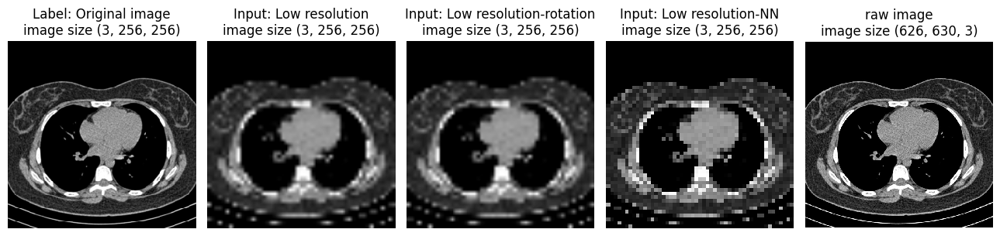

In [97]:
# Check transform using one example
image = Image.open(os.path.join(DATA_ROOT, "train", "Normal", "2.png")).convert('RGB')

orig_image = orig_transforms(image)
transformed_image = lowres_transforms(orig_image)
transformed_image_nn = nn_lowres_transforms(orig_image)
transformed_image_rotate = lowres_transforms(orig_rotate_transforms(image))

fig, axes = plt.subplots(1,5, figsize=(13,4))
axes[0].imshow(orig_image[0,:,:].numpy().squeeze(), cmap='gray', interpolation='none')
axes[0].set_title("Label: {}".format(f'Original image\nimage size {orig_image.numpy().shape}'))
axes[0].set_axis_off()

axes[1].imshow(transformed_image[0,:,:].numpy().squeeze(), cmap='gray', interpolation='none')
axes[1].set_title("Input: {}".format(f'Low resolution\nimage size {transformed_image.numpy().shape}'))
axes[1].set_axis_off()

axes[2].imshow(transformed_image_rotate[0,:,:].numpy().squeeze(), cmap='gray', interpolation='none')
axes[2].set_title("Input: {}".format(f'Low resolution-rotation\nimage size {transformed_image_rotate.numpy().shape}'))
axes[2].set_axis_off()

axes[3].imshow(transformed_image_nn[0,:,:].numpy().squeeze(), cmap='gray', interpolation='none')
axes[3].set_title("Input: {}".format(f'Low resolution-NN\nimage size {transformed_image_nn.numpy().shape}'))
axes[3].set_axis_off()

axes[4].imshow(image, cmap='gray', interpolation='none')
axes[4].set_title(f"raw image\nimage size {np.shape(image)}")
axes[4].set_axis_off()
plt.tight_layout()

# Dataset

In [99]:
class ChestCTScanDataset(Dataset):
    def __init__(self, data_root, data_type, orig_transforms, lowres_transforms=None):

        # Define the subdirectory based on data type. data_type should be either 'test' or 'train'
        self.path = os.path.join(data_root, data_type)

        # Define the classes (or types of images) in your dataset
        self.classes = ['Adenocarcinoma', 'Large cell carcinoma', 'Squamous cell carcinoma', 'Normal']
        self.input_paths = []

        # Load all images from each class
        for cls in self.classes:
            class_path = os.path.join(self.path, cls)
            self.input_paths.extend(glob(os.path.join(class_path, '*')))
        print(f"Data type: {data_type}, Number of images found:", len(self.input_paths))
        self.orig_transforms = orig_transforms
        self.lowres_transforms = lowres_transforms

    def __len__(self):
        return len(self.input_paths)

    def __getitem__(self, index):
        # get the image
        img_path = self.input_paths[index]
        img = Image.open(img_path).convert('RGB')

        # apply basic transformations for labels
        img = self.orig_transforms(img)
        sample = {'label': np.array(img)}

        # apply low-resolution transformations for inputs
        if self.lowres_transforms:
            img = self.lowres_transforms(img)
        sample['image'] = np.array(img)
        return sample


In [100]:
# Initialize your dataset
train_dataset = ChestCTScanDataset(DATA_ROOT, 'train', orig_transforms, lowres_transforms)
train_rotate_dataset = ChestCTScanDataset(DATA_ROOT, 'train', orig_rotate_transforms, lowres_transforms)
merged_train_dataset = torch.utils.data.ConcatDataset([train_dataset, train_rotate_dataset]) # data augmentation using random rotation
test_dataset = ChestCTScanDataset(DATA_ROOT, 'test', orig_transforms, lowres_transforms)

# Dataloader
train_dataloader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=0)
test_dataloader = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=0)

Data type: train, Number of images found: 586
Data type: train, Number of images found: 586
Data type: test, Number of images found: 315


# Model

In [9]:
criterion = VGGPerceptualLoss()

TypeError: ignored

In [101]:
# network and optimizer
torch.cuda.empty_cache()
model = RUNet()
model = model.cuda()

optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5, factor=0.5)

#loss function
criterion = VGGPerceptualLoss(device)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:10<00:00, 54.5MB/s]


# Train

Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


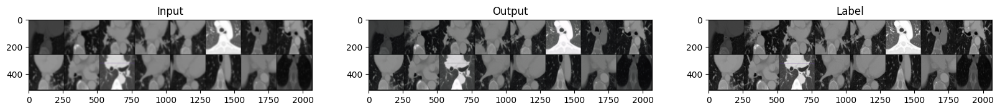

  3%|▎         | 1/39 [00:03<01:55,  3.05s/it]

Train Epoch: 0 [0/613 (0%)]	Loss: 3.256332


 79%|███████▉  | 31/39 [00:52<00:13,  1.69s/it]

Train Epoch: 0 [60/613 (77%)]	Loss: 4.095459


100%|██████████| 39/39 [01:04<00:00,  1.65s/it]


Mean loss on trainset: 166.1750612258911


  0%|          | 0/315 [00:00<?, ?it/s]

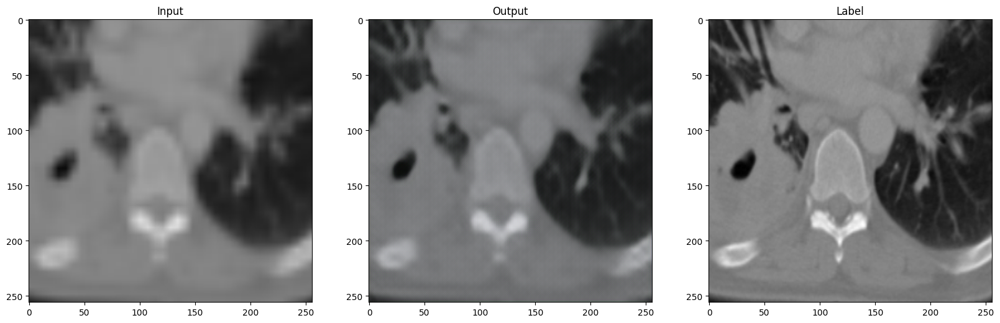

  0%|          | 1/315 [00:01<05:39,  1.08s/it]

Test Epoch: 0 [0/315 (0%)]	Loss: 4.167565


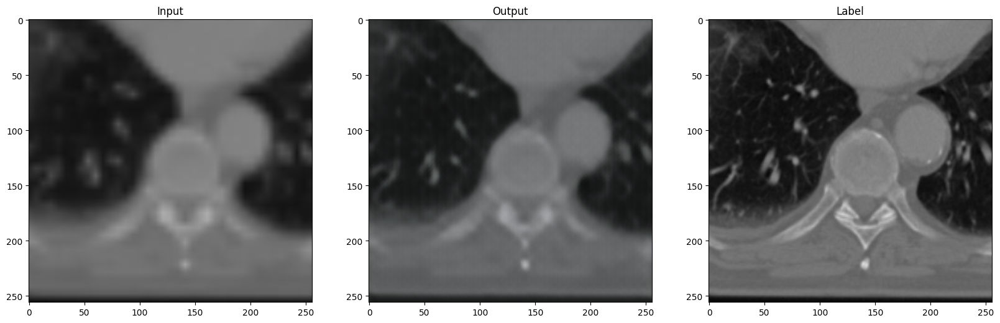

  1%|          | 2/315 [00:02<05:43,  1.10s/it]

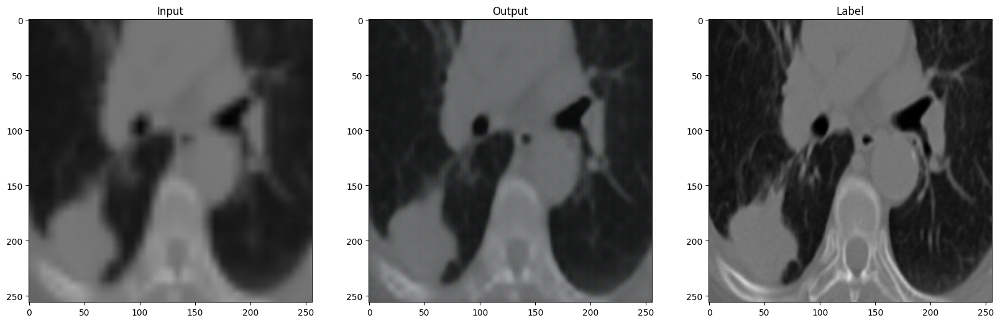

 11%|█▏        | 36/315 [00:04<00:11, 23.31it/s]

Test Epoch: 0 [60/315 (10%)]	Loss: 4.120690


 21%|██        | 66/315 [00:05<00:09, 24.95it/s]

Test Epoch: 0 [120/315 (19%)]	Loss: 4.545851


 30%|███       | 96/315 [00:06<00:08, 25.28it/s]

Test Epoch: 0 [180/315 (29%)]	Loss: 3.786514


 40%|████      | 126/315 [00:08<00:07, 25.12it/s]

Test Epoch: 0 [240/315 (38%)]	Loss: 3.423682


 50%|████▉     | 156/315 [00:09<00:06, 24.76it/s]

Test Epoch: 0 [300/315 (48%)]	Loss: 3.739305


 59%|█████▉    | 186/315 [00:10<00:05, 24.99it/s]

Test Epoch: 0 [360/315 (57%)]	Loss: 4.185000


 69%|██████▊   | 216/315 [00:11<00:03, 24.89it/s]

Test Epoch: 0 [420/315 (67%)]	Loss: 2.567971


 78%|███████▊  | 246/315 [00:12<00:02, 23.92it/s]

Test Epoch: 0 [480/315 (76%)]	Loss: 3.567257


 87%|████████▋ | 273/315 [00:14<00:02, 19.20it/s]

Test Epoch: 0 [540/315 (86%)]	Loss: 5.533360


 97%|█████████▋| 305/315 [00:15<00:00, 18.36it/s]

Test Epoch: 0 [600/315 (95%)]	Loss: 12.911463


100%|██████████| 315/315 [00:16<00:00, 19.08it/s]


Test loss: 1474.5953369140625
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


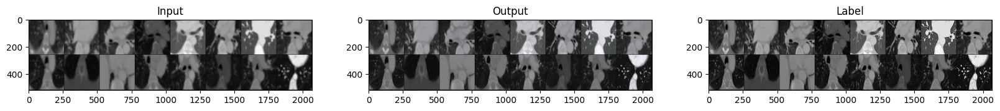

  3%|▎         | 1/39 [00:02<01:41,  2.68s/it]

Train Epoch: 1 [0/613 (0%)]	Loss: 4.249615


 79%|███████▉  | 31/39 [00:53<00:13,  1.69s/it]

Train Epoch: 1 [60/613 (77%)]	Loss: 4.013541


100%|██████████| 39/39 [01:06<00:00,  1.69s/it]


Mean loss on trainset: 162.85040545463562


  0%|          | 0/315 [00:00<?, ?it/s]

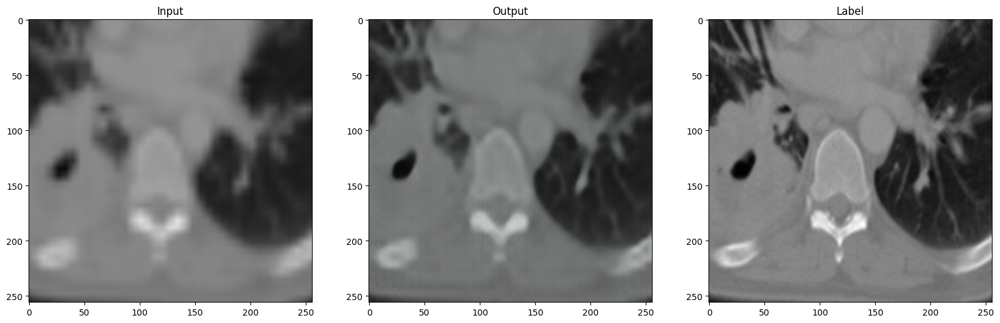

  0%|          | 1/315 [00:00<04:09,  1.26it/s]

Test Epoch: 1 [0/315 (0%)]	Loss: 4.065236


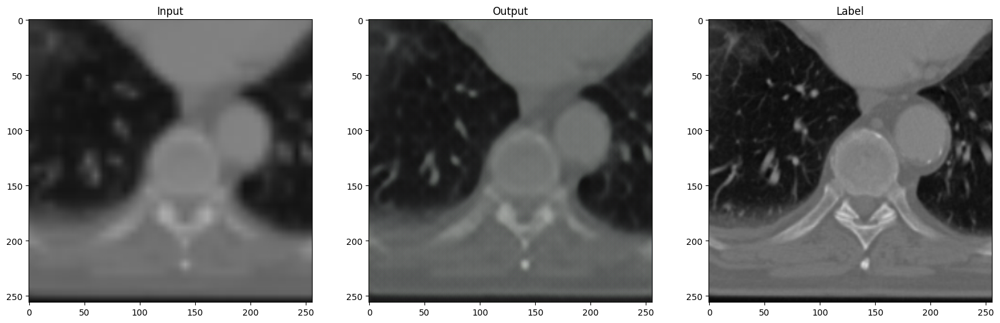

  1%|          | 2/315 [00:01<04:53,  1.07it/s]

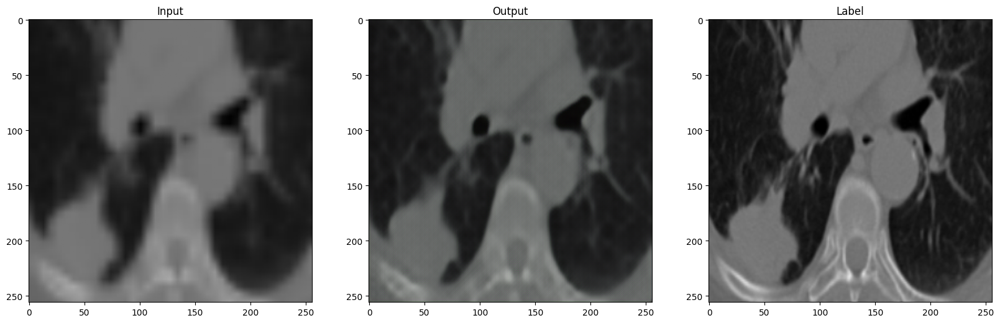

 11%|█         | 35/315 [00:04<00:12, 22.61it/s]

Test Epoch: 1 [60/315 (10%)]	Loss: 4.150987


 21%|██        | 65/315 [00:05<00:10, 24.83it/s]

Test Epoch: 1 [120/315 (19%)]	Loss: 4.445695


 30%|███       | 95/315 [00:06<00:08, 24.58it/s]

Test Epoch: 1 [180/315 (29%)]	Loss: 3.543664


 40%|███▉      | 125/315 [00:07<00:07, 24.67it/s]

Test Epoch: 1 [240/315 (38%)]	Loss: 3.188979


 49%|████▉     | 155/315 [00:08<00:06, 25.17it/s]

Test Epoch: 1 [300/315 (48%)]	Loss: 3.782526


 59%|█████▊    | 185/315 [00:10<00:05, 22.58it/s]

Test Epoch: 1 [360/315 (57%)]	Loss: 4.021896


 68%|██████▊   | 215/315 [00:11<00:04, 24.44it/s]

Test Epoch: 1 [420/315 (67%)]	Loss: 2.386834


 78%|███████▊  | 245/315 [00:12<00:03, 21.13it/s]

Test Epoch: 1 [480/315 (76%)]	Loss: 3.368298


 86%|████████▋ | 272/315 [00:13<00:02, 19.62it/s]

Test Epoch: 1 [540/315 (86%)]	Loss: 5.282382


 97%|█████████▋| 305/315 [00:15<00:00, 17.83it/s]

Test Epoch: 1 [600/315 (95%)]	Loss: 11.799379


100%|██████████| 315/315 [00:16<00:00, 19.24it/s]


Test loss: 1437.053466796875
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


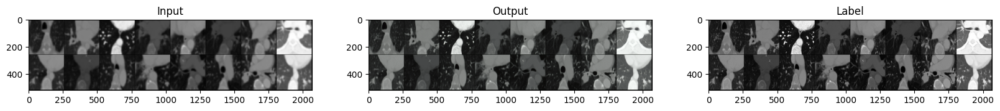

  3%|▎         | 1/39 [00:02<01:38,  2.59s/it]

Train Epoch: 2 [0/613 (0%)]	Loss: 3.625530


 79%|███████▉  | 31/39 [00:53<00:13,  1.70s/it]

Train Epoch: 2 [60/613 (77%)]	Loss: 4.780459


100%|██████████| 39/39 [01:06<00:00,  1.70s/it]


Mean loss on trainset: 157.29124426841736


  0%|          | 0/315 [00:00<?, ?it/s]

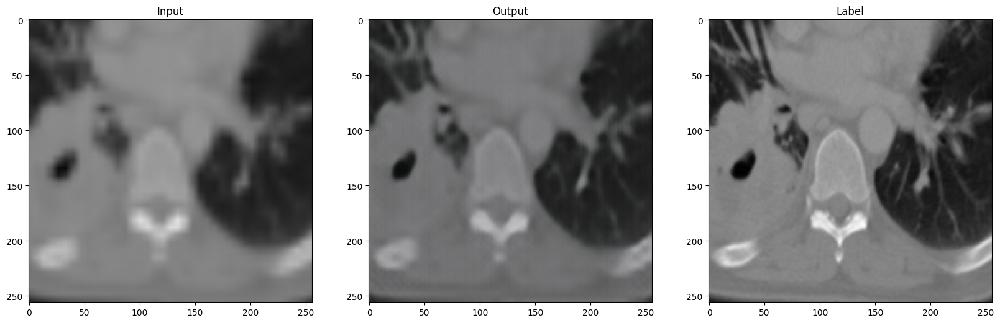

  0%|          | 1/315 [00:00<04:17,  1.22it/s]

Test Epoch: 2 [0/315 (0%)]	Loss: 3.947553


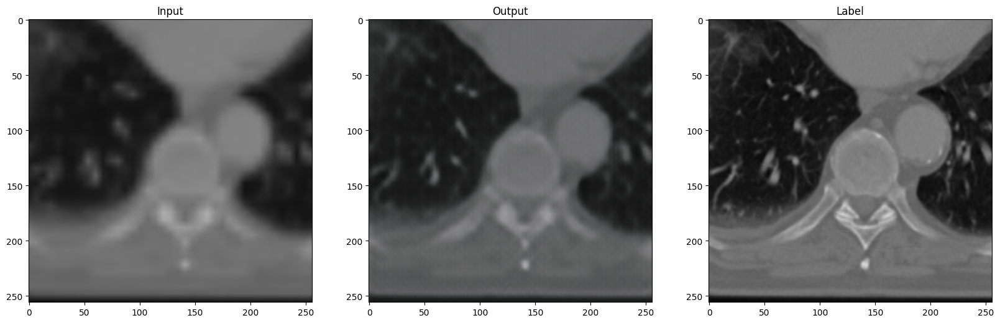

  1%|          | 2/315 [00:01<04:26,  1.18it/s]

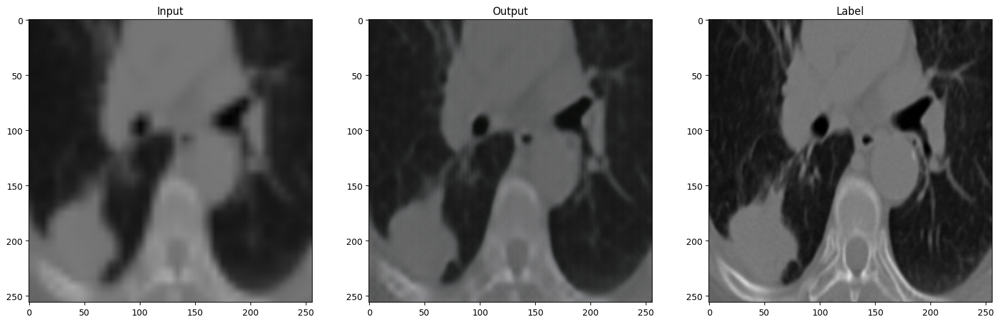

 11%|█         | 35/315 [00:03<00:12, 23.05it/s]

Test Epoch: 2 [60/315 (10%)]	Loss: 4.170380


 21%|██        | 65/315 [00:05<00:10, 24.68it/s]

Test Epoch: 2 [120/315 (19%)]	Loss: 4.320339


 30%|███       | 95/315 [00:06<00:08, 24.74it/s]

Test Epoch: 2 [180/315 (29%)]	Loss: 3.495225


 40%|███▉      | 125/315 [00:07<00:07, 25.11it/s]

Test Epoch: 2 [240/315 (38%)]	Loss: 3.137169


 49%|████▉     | 155/315 [00:08<00:06, 23.72it/s]

Test Epoch: 2 [300/315 (48%)]	Loss: 3.642437


 59%|█████▊    | 185/315 [00:09<00:05, 24.51it/s]

Test Epoch: 2 [360/315 (57%)]	Loss: 3.997429


 68%|██████▊   | 215/315 [00:11<00:04, 22.82it/s]

Test Epoch: 2 [420/315 (67%)]	Loss: 2.466358


 78%|███████▊  | 245/315 [00:12<00:03, 22.71it/s]

Test Epoch: 2 [480/315 (76%)]	Loss: 3.412292


 86%|████████▋ | 272/315 [00:13<00:02, 21.12it/s]

Test Epoch: 2 [540/315 (86%)]	Loss: 4.960485


 97%|█████████▋| 304/315 [00:15<00:00, 18.72it/s]

Test Epoch: 2 [600/315 (95%)]	Loss: 11.659963


100%|██████████| 315/315 [00:15<00:00, 19.83it/s]


Test loss: 1398.9063720703125
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]

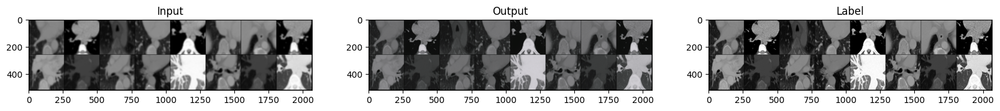

  3%|▎         | 1/39 [00:03<01:54,  3.01s/it]

Train Epoch: 3 [0/613 (0%)]	Loss: 3.989591


 79%|███████▉  | 31/39 [00:54<00:13,  1.69s/it]

Train Epoch: 3 [60/613 (77%)]	Loss: 4.343120


100%|██████████| 39/39 [01:07<00:00,  1.72s/it]


Mean loss on trainset: 154.6785182952881


  0%|          | 0/315 [00:00<?, ?it/s]

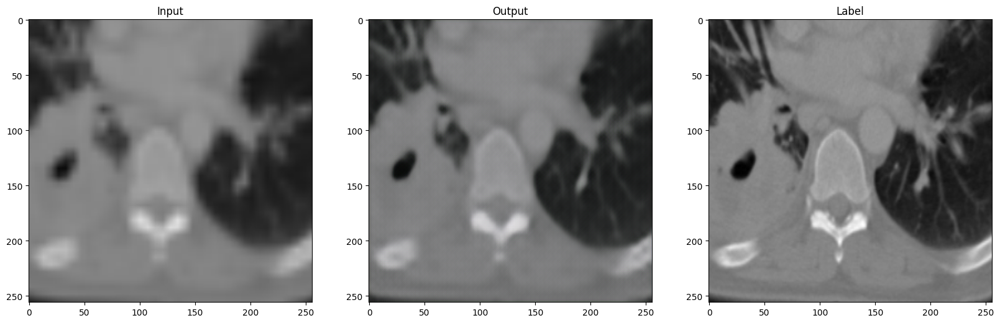

  0%|          | 1/315 [00:00<04:31,  1.16it/s]

Test Epoch: 3 [0/315 (0%)]	Loss: 4.116597


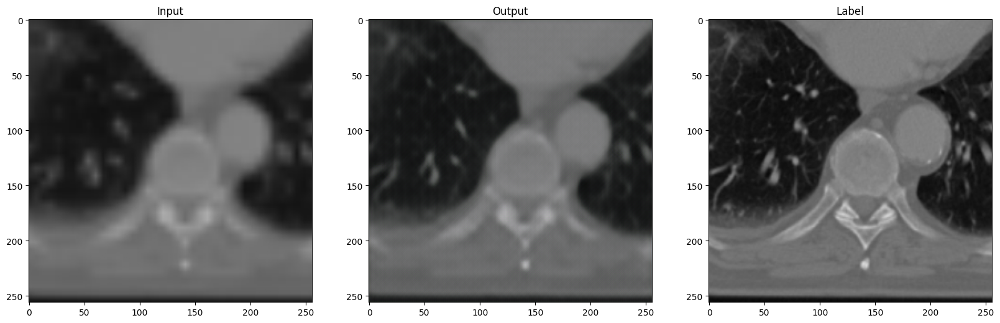

  1%|          | 2/315 [00:01<04:32,  1.15it/s]

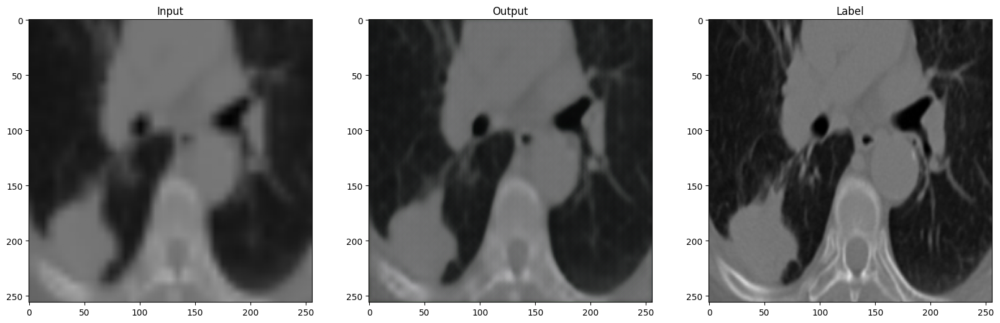

 11%|█         | 34/315 [00:03<00:12, 22.40it/s]

Test Epoch: 3 [60/315 (10%)]	Loss: 4.231271


 20%|██        | 64/315 [00:05<00:10, 24.45it/s]

Test Epoch: 3 [120/315 (19%)]	Loss: 4.512236


 30%|██▉       | 94/315 [00:06<00:09, 24.41it/s]

Test Epoch: 3 [180/315 (29%)]	Loss: 3.748716


 39%|███▉      | 124/315 [00:07<00:08, 21.90it/s]

Test Epoch: 3 [240/315 (38%)]	Loss: 3.467960


 49%|████▉     | 154/315 [00:08<00:06, 23.73it/s]

Test Epoch: 3 [300/315 (48%)]	Loss: 3.905959


 58%|█████▊    | 184/315 [00:10<00:05, 23.42it/s]

Test Epoch: 3 [360/315 (57%)]	Loss: 4.135746


 68%|██████▊   | 214/315 [00:11<00:04, 23.54it/s]

Test Epoch: 3 [420/315 (67%)]	Loss: 2.707390


 77%|███████▋  | 244/315 [00:12<00:03, 22.82it/s]

Test Epoch: 3 [480/315 (76%)]	Loss: 3.685124


 87%|████████▋ | 274/315 [00:13<00:02, 19.20it/s]

Test Epoch: 3 [540/315 (86%)]	Loss: 4.622419


 97%|█████████▋| 304/315 [00:15<00:00, 19.91it/s]

Test Epoch: 3 [600/315 (95%)]	Loss: 12.013867


100%|██████████| 315/315 [00:15<00:00, 19.70it/s]


Test loss: 1436.5855712890625
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]

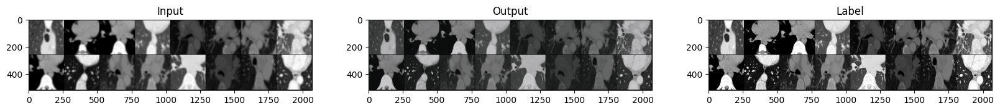

  3%|▎         | 1/39 [00:03<02:02,  3.21s/it]

Train Epoch: 4 [0/613 (0%)]	Loss: 4.705978


 79%|███████▉  | 31/39 [00:54<00:13,  1.73s/it]

Train Epoch: 4 [60/613 (77%)]	Loss: 4.659276


100%|██████████| 39/39 [01:07<00:00,  1.73s/it]


Mean loss on trainset: 150.9542088508606


  0%|          | 0/315 [00:00<?, ?it/s]

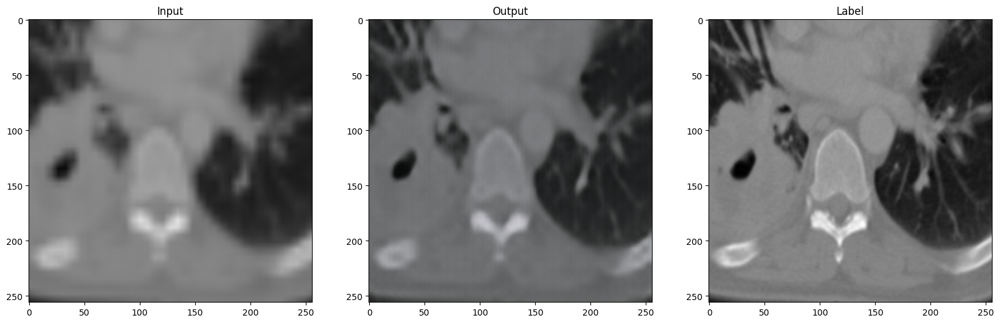

  0%|          | 1/315 [00:01<05:51,  1.12s/it]

Test Epoch: 4 [0/315 (0%)]	Loss: 3.845548


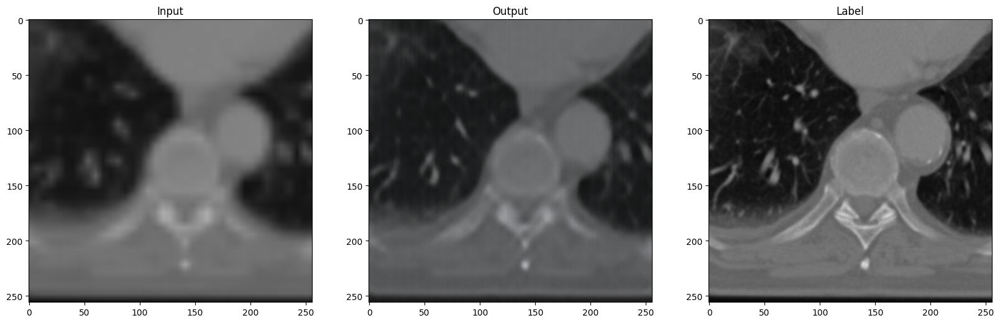

  1%|          | 2/315 [00:02<05:12,  1.00it/s]

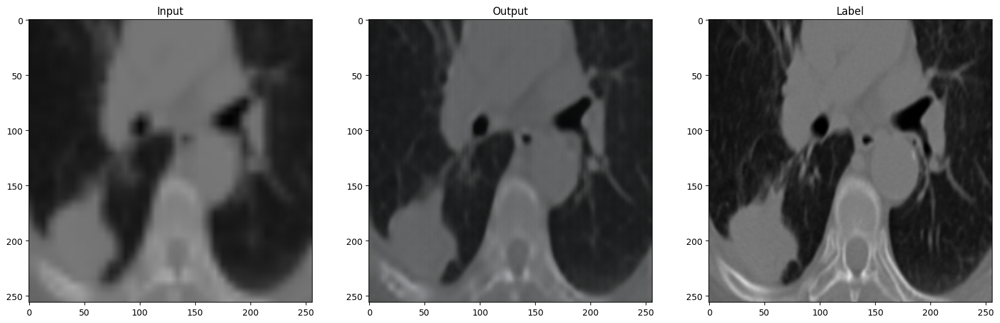

 11%|█         | 35/315 [00:04<00:12, 22.13it/s]

Test Epoch: 4 [60/315 (10%)]	Loss: 3.916173


 21%|██        | 65/315 [00:05<00:10, 24.35it/s]

Test Epoch: 4 [120/315 (19%)]	Loss: 4.204245


 30%|███       | 95/315 [00:06<00:08, 24.62it/s]

Test Epoch: 4 [180/315 (29%)]	Loss: 3.502863


 40%|███▉      | 125/315 [00:07<00:07, 24.56it/s]

Test Epoch: 4 [240/315 (38%)]	Loss: 3.080770


 49%|████▉     | 155/315 [00:09<00:06, 23.61it/s]

Test Epoch: 4 [300/315 (48%)]	Loss: 3.577521


 59%|█████▊    | 185/315 [00:10<00:05, 24.57it/s]

Test Epoch: 4 [360/315 (57%)]	Loss: 3.850505


 68%|██████▊   | 215/315 [00:11<00:04, 23.37it/s]

Test Epoch: 4 [420/315 (67%)]	Loss: 2.329958


 78%|███████▊  | 245/315 [00:12<00:03, 22.65it/s]

Test Epoch: 4 [480/315 (76%)]	Loss: 3.333588


 86%|████████▋ | 272/315 [00:14<00:02, 20.17it/s]

Test Epoch: 4 [540/315 (86%)]	Loss: 4.225817


 97%|█████████▋| 305/315 [00:15<00:00, 20.53it/s]

Test Epoch: 4 [600/315 (95%)]	Loss: 11.435614


100%|██████████| 315/315 [00:16<00:00, 19.28it/s]


Test loss: 1351.63427734375
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]

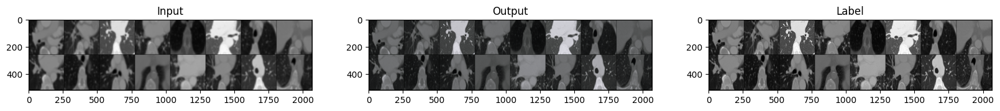

  3%|▎         | 1/39 [00:03<02:00,  3.18s/it]

Train Epoch: 5 [0/613 (0%)]	Loss: 3.650063


 79%|███████▉  | 31/39 [00:55<00:13,  1.71s/it]

Train Epoch: 5 [60/613 (77%)]	Loss: 3.191091


100%|██████████| 39/39 [01:08<00:00,  1.74s/it]


Mean loss on trainset: 149.69553518295288


  0%|          | 0/315 [00:00<?, ?it/s]

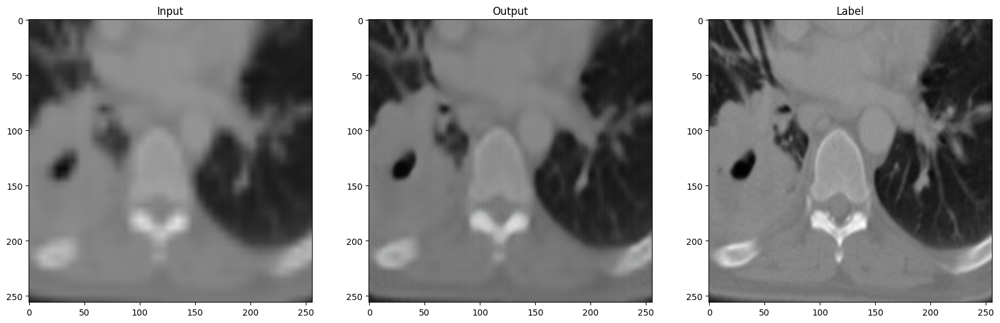

  0%|          | 1/315 [00:00<05:07,  1.02it/s]

Test Epoch: 5 [0/315 (0%)]	Loss: 3.889250


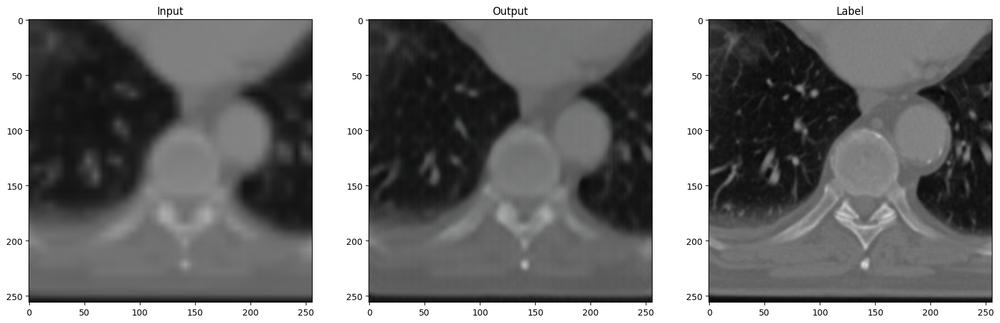

  1%|          | 2/315 [00:01<04:59,  1.04it/s]

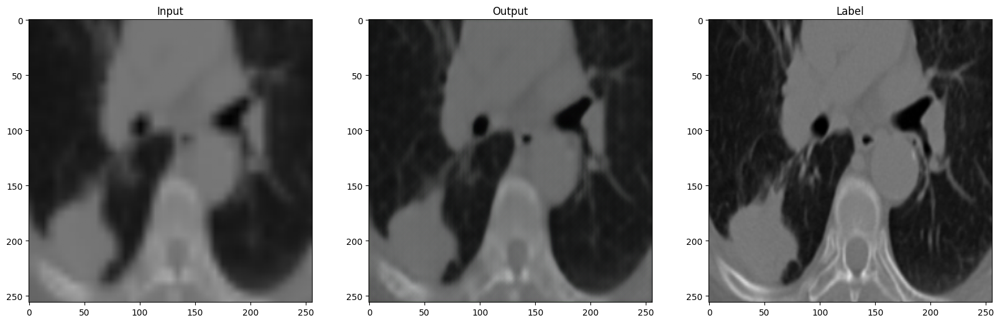

 11%|█▏        | 36/315 [00:04<00:12, 22.68it/s]

Test Epoch: 5 [60/315 (10%)]	Loss: 4.049568


 21%|██        | 66/315 [00:05<00:10, 24.36it/s]

Test Epoch: 5 [120/315 (19%)]	Loss: 4.327528


 30%|███       | 96/315 [00:06<00:08, 24.44it/s]

Test Epoch: 5 [180/315 (29%)]	Loss: 3.528666


 40%|████      | 126/315 [00:07<00:07, 24.30it/s]

Test Epoch: 5 [240/315 (38%)]	Loss: 3.208919


 50%|████▉     | 156/315 [00:09<00:06, 23.43it/s]

Test Epoch: 5 [300/315 (48%)]	Loss: 3.648579


 59%|█████▉    | 186/315 [00:10<00:05, 24.12it/s]

Test Epoch: 5 [360/315 (57%)]	Loss: 4.029206


 69%|██████▊   | 216/315 [00:11<00:04, 23.89it/s]

Test Epoch: 5 [420/315 (67%)]	Loss: 2.468410


 77%|███████▋  | 243/315 [00:12<00:03, 21.29it/s]

Test Epoch: 5 [480/315 (76%)]	Loss: 3.471930


 87%|████████▋ | 273/315 [00:14<00:02, 19.13it/s]

Test Epoch: 5 [540/315 (86%)]	Loss: 4.255449


 97%|█████████▋| 305/315 [00:15<00:00, 20.23it/s]

Test Epoch: 5 [600/315 (95%)]	Loss: 11.305921


100%|██████████| 315/315 [00:16<00:00, 19.19it/s]


Test loss: 1379.451171875
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


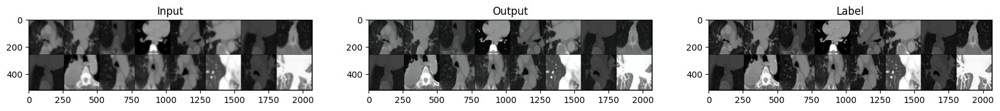

  3%|▎         | 1/39 [00:03<02:05,  3.31s/it]

Train Epoch: 6 [0/613 (0%)]	Loss: 3.371546


 79%|███████▉  | 31/39 [00:56<00:13,  1.73s/it]

Train Epoch: 6 [60/613 (77%)]	Loss: 3.252873


100%|██████████| 39/39 [01:08<00:00,  1.77s/it]


Mean loss on trainset: 145.4729220867157


  0%|          | 0/315 [00:00<?, ?it/s]

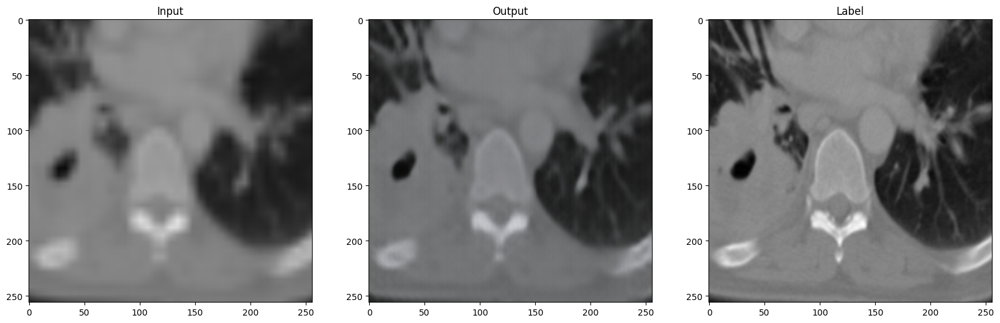

  0%|          | 1/315 [00:01<05:21,  1.02s/it]

Test Epoch: 6 [0/315 (0%)]	Loss: 3.746559


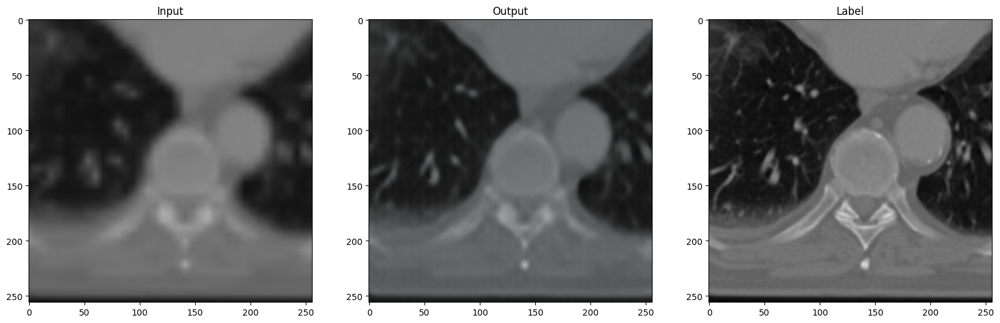

  1%|          | 2/315 [00:02<05:14,  1.00s/it]

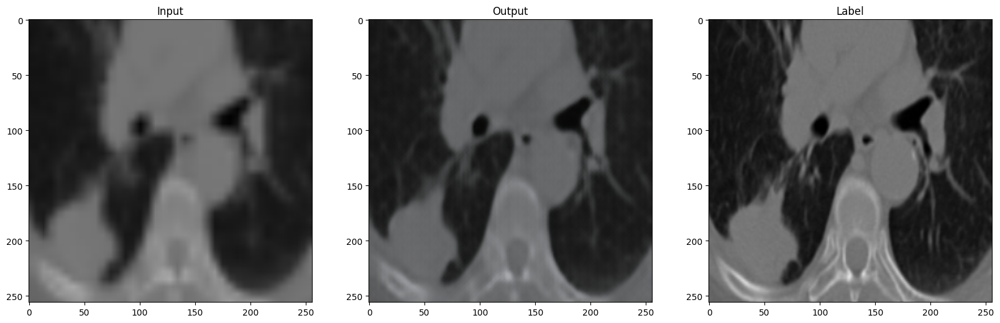

 11%|█▏        | 36/315 [00:04<00:12, 22.47it/s]

Test Epoch: 6 [60/315 (10%)]	Loss: 3.755602


 21%|██        | 66/315 [00:05<00:10, 24.21it/s]

Test Epoch: 6 [120/315 (19%)]	Loss: 4.147656


 30%|███       | 96/315 [00:06<00:09, 24.26it/s]

Test Epoch: 6 [180/315 (29%)]	Loss: 3.452754


 40%|████      | 126/315 [00:08<00:07, 24.30it/s]

Test Epoch: 6 [240/315 (38%)]	Loss: 3.030604


 49%|████▊     | 153/315 [00:09<00:07, 20.47it/s]

Test Epoch: 6 [300/315 (48%)]	Loss: 3.499812


 58%|█████▊    | 183/315 [00:10<00:06, 21.29it/s]

Test Epoch: 6 [360/315 (57%)]	Loss: 3.747008


 68%|██████▊   | 213/315 [00:12<00:04, 20.72it/s]

Test Epoch: 6 [420/315 (67%)]	Loss: 2.294091


 78%|███████▊  | 246/315 [00:13<00:03, 22.50it/s]

Test Epoch: 6 [480/315 (76%)]	Loss: 3.308745


 87%|████████▋ | 273/315 [00:14<00:02, 19.74it/s]

Test Epoch: 6 [540/315 (86%)]	Loss: 3.560814


 97%|█████████▋| 305/315 [00:16<00:00, 19.57it/s]

Test Epoch: 6 [600/315 (95%)]	Loss: 10.766669


100%|██████████| 315/315 [00:16<00:00, 18.55it/s]


Test loss: 1297.064697265625
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]

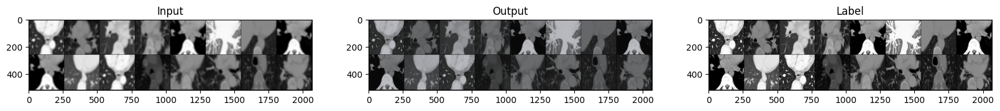

  3%|▎         | 1/39 [00:03<02:03,  3.25s/it]

Train Epoch: 7 [0/613 (0%)]	Loss: 4.248349


 79%|███████▉  | 31/39 [00:56<00:14,  1.76s/it]

Train Epoch: 7 [60/613 (77%)]	Loss: 3.748855


100%|██████████| 39/39 [01:09<00:00,  1.77s/it]


Mean loss on trainset: 143.99213361740112


  0%|          | 0/315 [00:00<?, ?it/s]

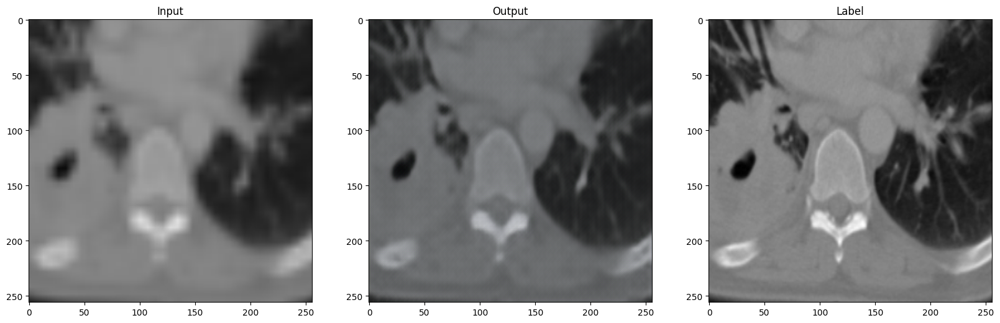

  0%|          | 1/315 [00:01<06:08,  1.17s/it]

Test Epoch: 7 [0/315 (0%)]	Loss: 3.660378


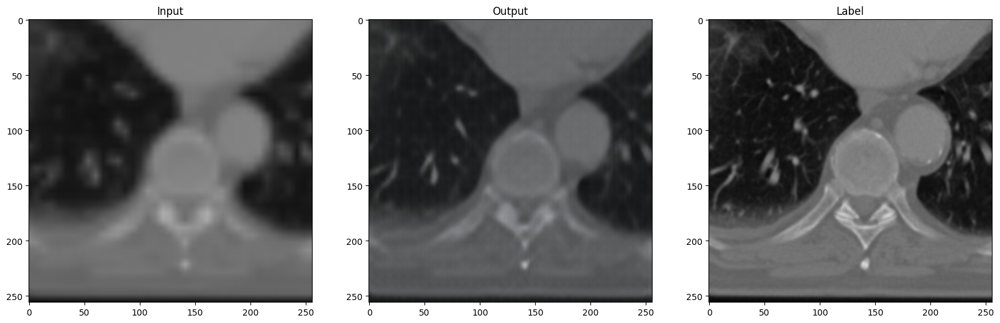

  1%|          | 2/315 [00:02<05:38,  1.08s/it]

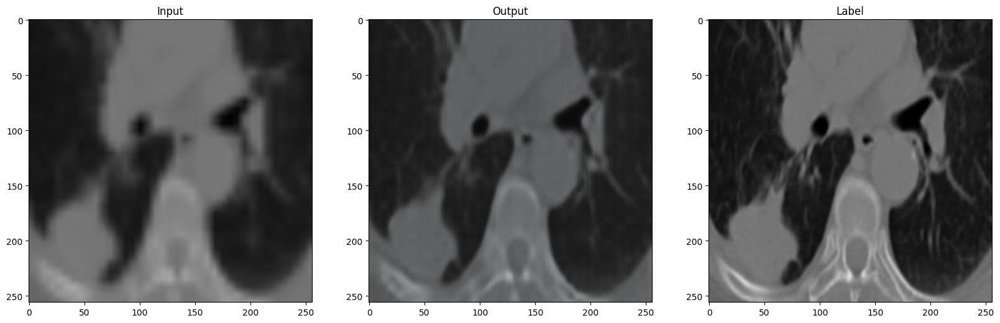

 11%|█         | 35/315 [00:04<00:12, 22.58it/s]

Test Epoch: 7 [60/315 (10%)]	Loss: 3.903329


 21%|██        | 65/315 [00:05<00:10, 24.27it/s]

Test Epoch: 7 [120/315 (19%)]	Loss: 4.102077


 30%|███       | 95/315 [00:06<00:09, 23.87it/s]

Test Epoch: 7 [180/315 (29%)]	Loss: 3.384073


 40%|███▉      | 125/315 [00:08<00:07, 24.21it/s]

Test Epoch: 7 [240/315 (38%)]	Loss: 2.995606


 49%|████▉     | 155/315 [00:09<00:06, 24.49it/s]

Test Epoch: 7 [300/315 (48%)]	Loss: 3.450476


 59%|█████▊    | 185/315 [00:10<00:05, 24.63it/s]

Test Epoch: 7 [360/315 (57%)]	Loss: 3.691403


 68%|██████▊   | 215/315 [00:11<00:04, 21.11it/s]

Test Epoch: 7 [420/315 (67%)]	Loss: 2.319541


 78%|███████▊  | 245/315 [00:13<00:03, 21.93it/s]

Test Epoch: 7 [480/315 (76%)]	Loss: 3.286625


 86%|████████▋ | 272/315 [00:14<00:02, 18.71it/s]

Test Epoch: 7 [540/315 (86%)]	Loss: 3.584739


 96%|█████████▌| 303/315 [00:16<00:00, 15.19it/s]

Test Epoch: 7 [600/315 (95%)]	Loss: 10.001699


100%|██████████| 315/315 [00:17<00:00, 18.32it/s]


Test loss: 1291.807861328125
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]

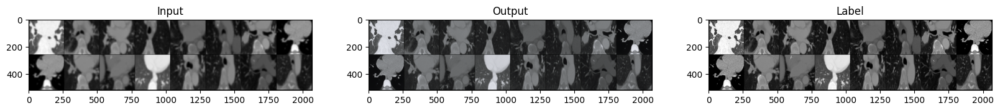

  3%|▎         | 1/39 [00:03<02:00,  3.16s/it]

Train Epoch: 8 [0/613 (0%)]	Loss: 3.627301


 79%|███████▉  | 31/39 [00:57<00:14,  1.80s/it]

Train Epoch: 8 [60/613 (77%)]	Loss: 4.050039


100%|██████████| 39/39 [01:09<00:00,  1.79s/it]


Mean loss on trainset: 139.53291130065918


  0%|          | 0/315 [00:00<?, ?it/s]

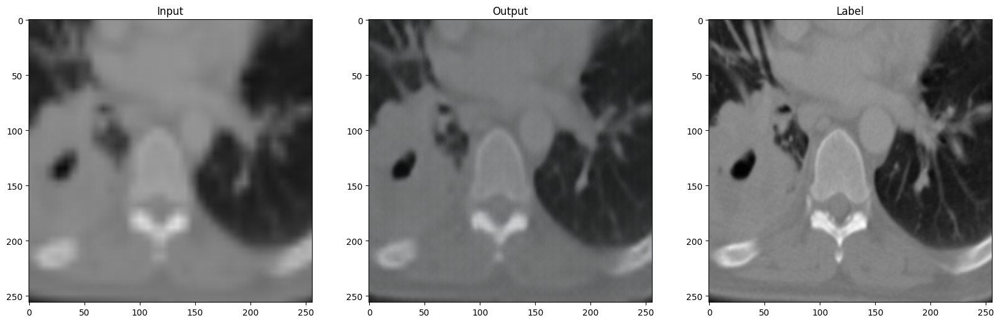

  0%|          | 1/315 [00:01<06:12,  1.19s/it]

Test Epoch: 8 [0/315 (0%)]	Loss: 3.639387


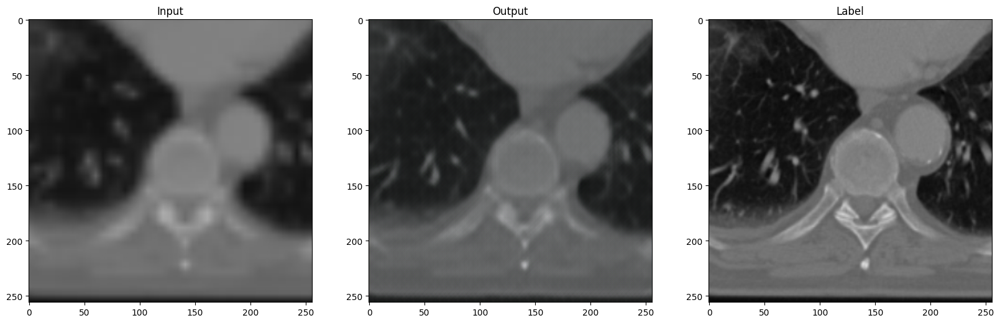

  1%|          | 2/315 [00:02<06:13,  1.19s/it]

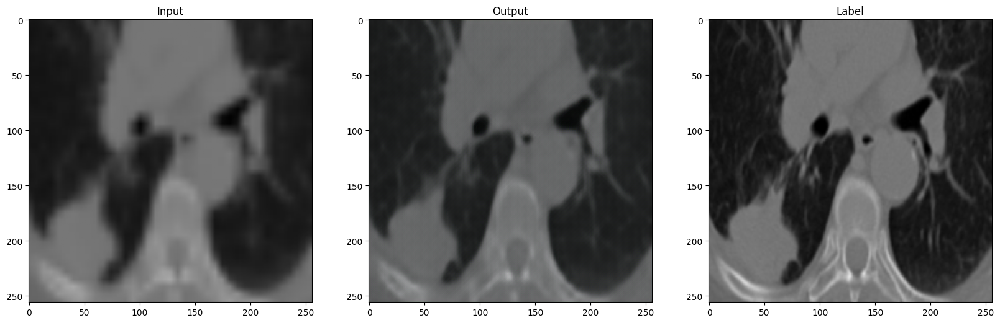

 11%|█         | 35/315 [00:04<00:13, 21.48it/s]

Test Epoch: 8 [60/315 (10%)]	Loss: 3.780147


 21%|██        | 65/315 [00:06<00:10, 24.22it/s]

Test Epoch: 8 [120/315 (19%)]	Loss: 4.082381


 30%|███       | 95/315 [00:07<00:09, 24.22it/s]

Test Epoch: 8 [180/315 (29%)]	Loss: 3.359229


 40%|███▉      | 125/315 [00:08<00:07, 24.27it/s]

Test Epoch: 8 [240/315 (38%)]	Loss: 2.984081


 49%|████▉     | 155/315 [00:09<00:06, 24.55it/s]

Test Epoch: 8 [300/315 (48%)]	Loss: 3.413585


 59%|█████▊    | 185/315 [00:10<00:05, 24.43it/s]

Test Epoch: 8 [360/315 (57%)]	Loss: 3.670653


 68%|██████▊   | 215/315 [00:12<00:04, 24.91it/s]

Test Epoch: 8 [420/315 (67%)]	Loss: 2.233944


 78%|███████▊  | 245/315 [00:13<00:03, 23.08it/s]

Test Epoch: 8 [480/315 (76%)]	Loss: 3.222793


 86%|████████▋ | 272/315 [00:14<00:02, 20.22it/s]

Test Epoch: 8 [540/315 (86%)]	Loss: 3.229933


 96%|█████████▌| 303/315 [00:16<00:00, 19.46it/s]

Test Epoch: 8 [600/315 (95%)]	Loss: 10.559363


100%|██████████| 315/315 [00:16<00:00, 18.85it/s]


Test loss: 1274.12451171875
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


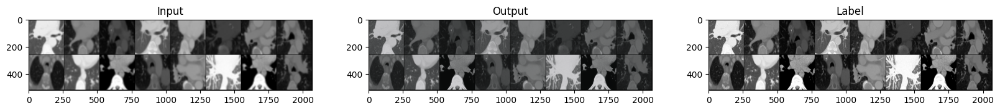

  3%|▎         | 1/39 [00:03<02:21,  3.72s/it]

Train Epoch: 9 [0/613 (0%)]	Loss: 3.446865


 79%|███████▉  | 31/39 [00:57<00:14,  1.75s/it]

Train Epoch: 9 [60/613 (77%)]	Loss: 3.597305


100%|██████████| 39/39 [01:10<00:00,  1.80s/it]


Mean loss on trainset: 134.04038548469543


  0%|          | 0/315 [00:00<?, ?it/s]

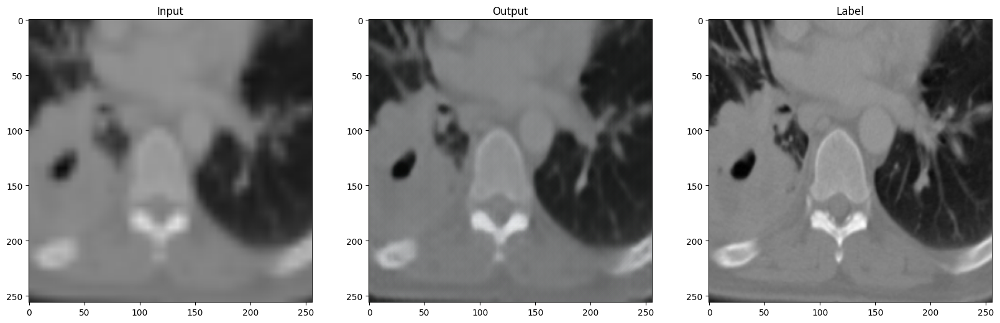

  0%|          | 1/315 [00:01<07:57,  1.52s/it]

Test Epoch: 9 [0/315 (0%)]	Loss: 3.644052


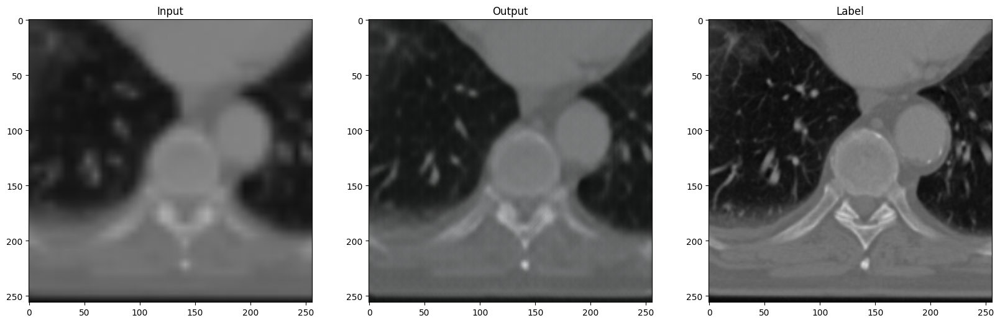

  1%|          | 2/315 [00:02<06:53,  1.32s/it]

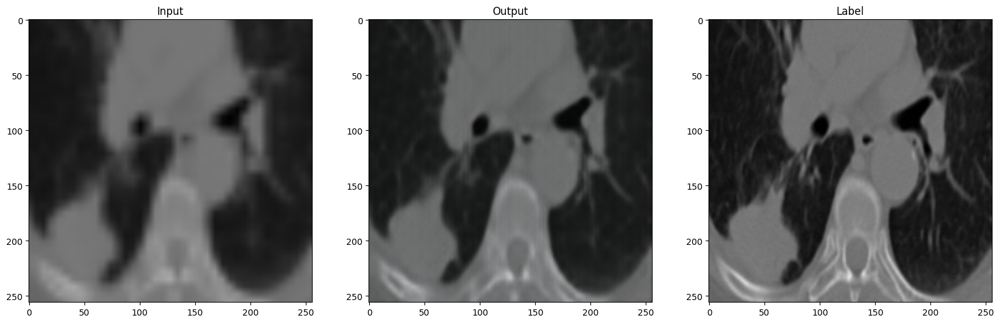

 11%|█         | 34/315 [00:05<00:13, 20.75it/s]

Test Epoch: 9 [60/315 (10%)]	Loss: 3.766786


 20%|██        | 64/315 [00:06<00:10, 24.20it/s]

Test Epoch: 9 [120/315 (19%)]	Loss: 4.029855


 30%|██▉       | 94/315 [00:07<00:09, 24.47it/s]

Test Epoch: 9 [180/315 (29%)]	Loss: 3.321373


 39%|███▉      | 124/315 [00:08<00:07, 24.28it/s]

Test Epoch: 9 [240/315 (38%)]	Loss: 3.005371


 49%|████▉     | 154/315 [00:09<00:06, 24.78it/s]

Test Epoch: 9 [300/315 (48%)]	Loss: 3.408090


 58%|█████▊    | 184/315 [00:11<00:05, 23.92it/s]

Test Epoch: 9 [360/315 (57%)]	Loss: 3.628275


 68%|██████▊   | 214/315 [00:12<00:04, 23.89it/s]

Test Epoch: 9 [420/315 (67%)]	Loss: 2.247699


 77%|███████▋  | 244/315 [00:13<00:03, 22.57it/s]

Test Epoch: 9 [480/315 (76%)]	Loss: 3.308115


 87%|████████▋ | 273/315 [00:15<00:02, 17.75it/s]

Test Epoch: 9 [540/315 (86%)]	Loss: 2.896407


 97%|█████████▋| 304/315 [00:16<00:00, 18.53it/s]

Test Epoch: 9 [600/315 (95%)]	Loss: 9.423614


100%|██████████| 315/315 [00:17<00:00, 18.01it/s]


Test loss: 1239.5162353515625
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


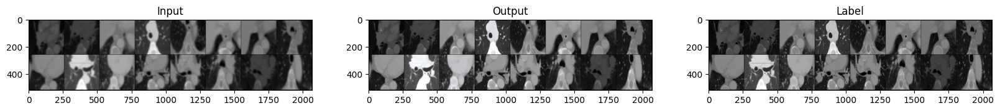

  3%|▎         | 1/39 [00:03<02:27,  3.89s/it]

Train Epoch: 10 [0/613 (0%)]	Loss: 2.951168


 79%|███████▉  | 31/39 [00:57<00:14,  1.77s/it]

Train Epoch: 10 [60/613 (77%)]	Loss: 3.022255


100%|██████████| 39/39 [01:10<00:00,  1.80s/it]


Mean loss on trainset: 134.42767667770386


  0%|          | 0/315 [00:00<?, ?it/s]

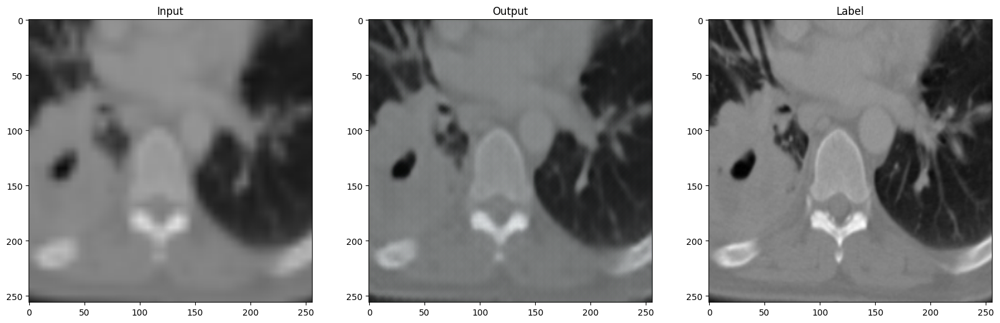

  0%|          | 1/315 [00:01<06:21,  1.22s/it]

Test Epoch: 10 [0/315 (0%)]	Loss: 3.635280


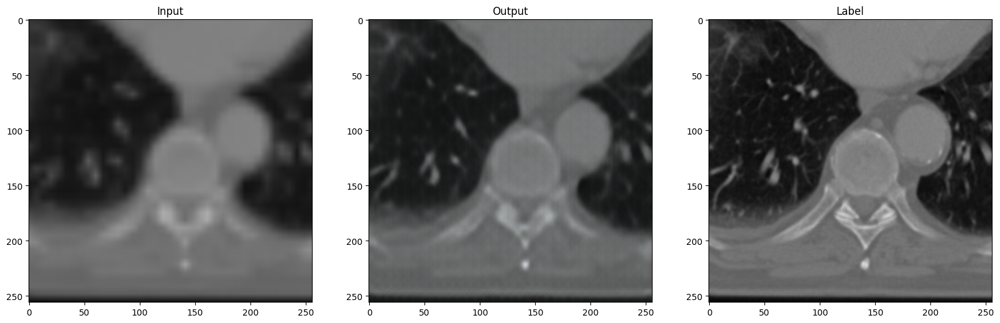

  1%|          | 2/315 [00:02<06:17,  1.21s/it]

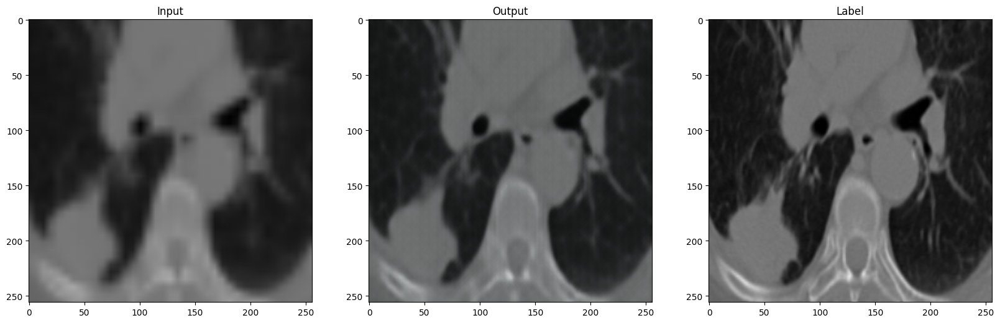

 11%|█         | 34/315 [00:05<00:13, 20.62it/s]

Test Epoch: 10 [60/315 (10%)]	Loss: 3.730724


 20%|██        | 64/315 [00:06<00:10, 22.88it/s]

Test Epoch: 10 [120/315 (19%)]	Loss: 4.056063


 30%|██▉       | 94/315 [00:07<00:09, 23.81it/s]

Test Epoch: 10 [180/315 (29%)]	Loss: 3.361097


 39%|███▉      | 124/315 [00:09<00:08, 23.53it/s]

Test Epoch: 10 [240/315 (38%)]	Loss: 2.959331


 49%|████▉     | 154/315 [00:10<00:06, 23.78it/s]

Test Epoch: 10 [300/315 (48%)]	Loss: 3.390409


 58%|█████▊    | 184/315 [00:11<00:05, 24.11it/s]

Test Epoch: 10 [360/315 (57%)]	Loss: 3.610739


 68%|██████▊   | 214/315 [00:12<00:04, 24.15it/s]

Test Epoch: 10 [420/315 (67%)]	Loss: 2.249907


 77%|███████▋  | 244/315 [00:13<00:02, 24.58it/s]

Test Epoch: 10 [480/315 (76%)]	Loss: 3.270952


 87%|████████▋ | 274/315 [00:15<00:02, 20.36it/s]

Test Epoch: 10 [540/315 (86%)]	Loss: 2.856512


 96%|█████████▌| 303/315 [00:16<00:00, 19.37it/s]

Test Epoch: 10 [600/315 (95%)]	Loss: 9.122257


100%|██████████| 315/315 [00:17<00:00, 18.31it/s]


Test loss: 1217.0762939453125
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


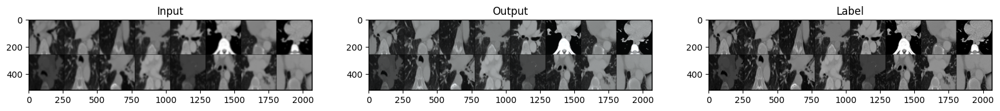

  3%|▎         | 1/39 [00:03<02:25,  3.82s/it]

Train Epoch: 11 [0/613 (0%)]	Loss: 2.868927


 79%|███████▉  | 31/39 [00:57<00:14,  1.76s/it]

Train Epoch: 11 [60/613 (77%)]	Loss: 3.388754


100%|██████████| 39/39 [01:10<00:00,  1.82s/it]


Mean loss on trainset: 131.07010626792908


  0%|          | 0/315 [00:00<?, ?it/s]

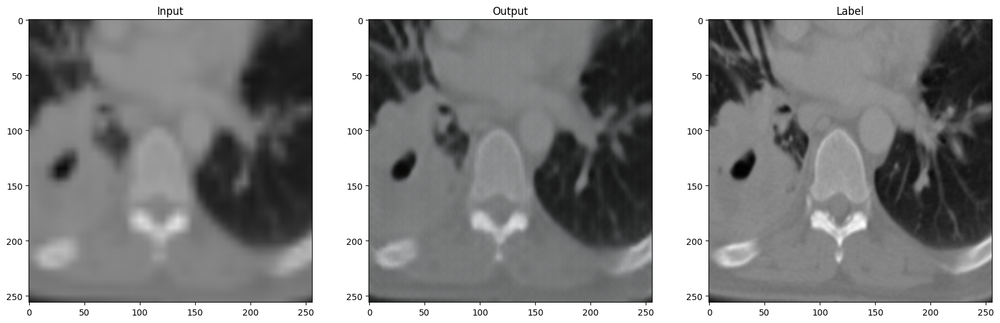

  0%|          | 1/315 [00:01<05:36,  1.07s/it]

Test Epoch: 11 [0/315 (0%)]	Loss: 3.613684


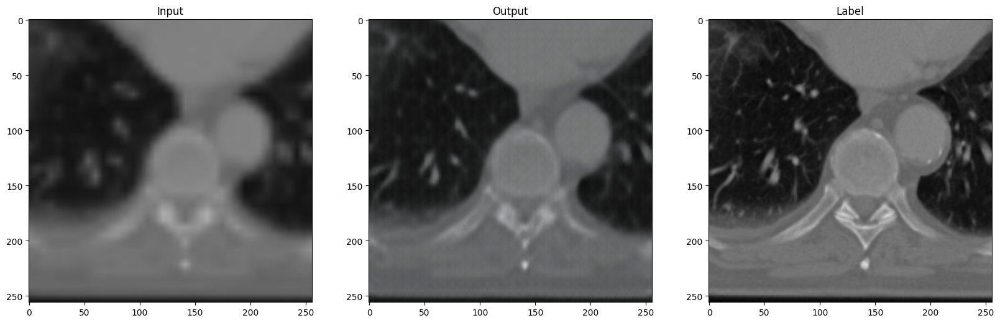

  1%|          | 2/315 [00:02<05:53,  1.13s/it]

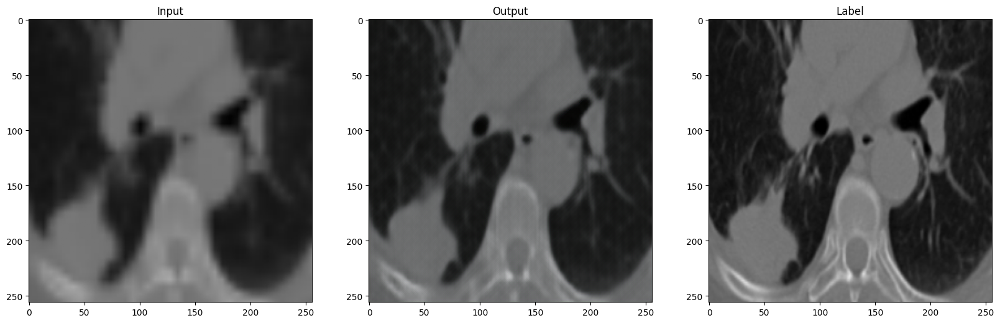

 11%|█         | 34/315 [00:04<00:15, 18.18it/s]

Test Epoch: 11 [60/315 (10%)]	Loss: 3.688157


 20%|██        | 64/315 [00:06<00:11, 22.22it/s]

Test Epoch: 11 [120/315 (19%)]	Loss: 3.985692


 30%|██▉       | 94/315 [00:07<00:10, 21.46it/s]

Test Epoch: 11 [180/315 (29%)]	Loss: 3.339770


 39%|███▉      | 124/315 [00:08<00:08, 23.23it/s]

Test Epoch: 11 [240/315 (38%)]	Loss: 2.886929


 49%|████▉     | 154/315 [00:10<00:07, 20.85it/s]

Test Epoch: 11 [300/315 (48%)]	Loss: 3.389368


 58%|█████▊    | 184/315 [00:11<00:06, 21.35it/s]

Test Epoch: 11 [360/315 (57%)]	Loss: 3.651019


 68%|██████▊   | 214/315 [00:13<00:04, 23.63it/s]

Test Epoch: 11 [420/315 (67%)]	Loss: 2.194271


 77%|███████▋  | 244/315 [00:14<00:02, 24.52it/s]

Test Epoch: 11 [480/315 (76%)]	Loss: 3.230442


 87%|████████▋ | 274/315 [00:15<00:02, 19.79it/s]

Test Epoch: 11 [540/315 (86%)]	Loss: 2.920890


 96%|█████████▌| 303/315 [00:16<00:00, 19.80it/s]

Test Epoch: 11 [600/315 (95%)]	Loss: 8.616342


100%|██████████| 315/315 [00:17<00:00, 17.94it/s]


Test loss: 1208.339111328125
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


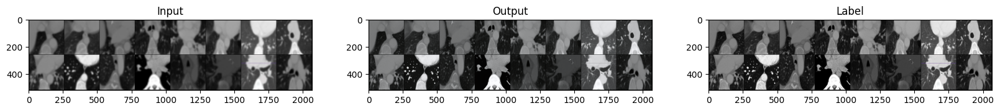

  3%|▎         | 1/39 [00:03<02:03,  3.24s/it]

Train Epoch: 12 [0/613 (0%)]	Loss: 2.861619


 79%|███████▉  | 31/39 [00:57<00:14,  1.76s/it]

Train Epoch: 12 [60/613 (77%)]	Loss: 3.430562


100%|██████████| 39/39 [01:10<00:00,  1.81s/it]


Mean loss on trainset: 126.26102948188782


  0%|          | 0/315 [00:00<?, ?it/s]

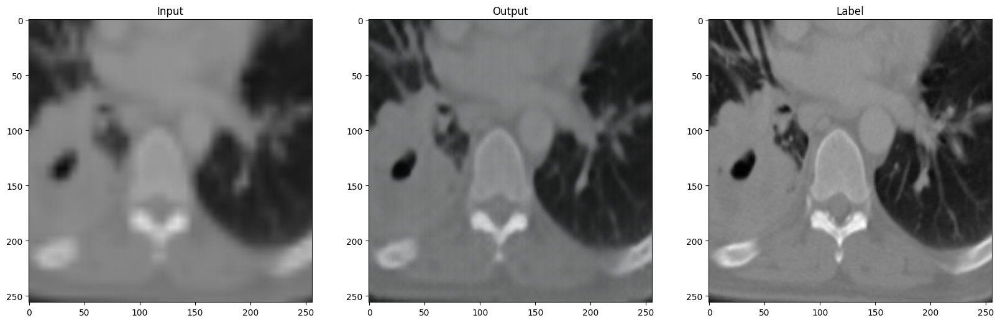

  0%|          | 1/315 [00:01<05:39,  1.08s/it]

Test Epoch: 12 [0/315 (0%)]	Loss: 3.626032


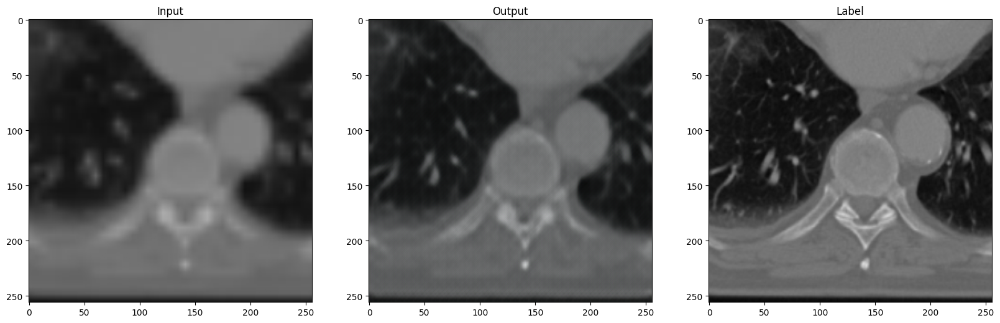

  1%|          | 2/315 [00:02<05:35,  1.07s/it]

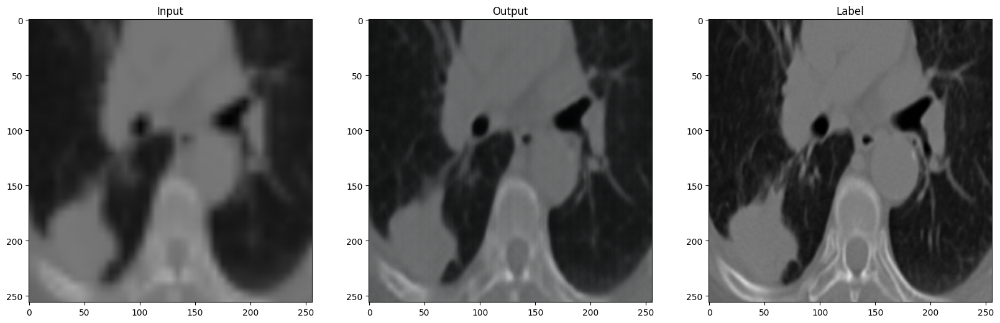

 11%|█         | 35/315 [00:04<00:12, 21.95it/s]

Test Epoch: 12 [60/315 (10%)]	Loss: 3.720212


 21%|██        | 65/315 [00:05<00:10, 24.22it/s]

Test Epoch: 12 [120/315 (19%)]	Loss: 4.015373


 30%|███       | 95/315 [00:06<00:09, 24.39it/s]

Test Epoch: 12 [180/315 (29%)]	Loss: 3.298401


 40%|███▉      | 125/315 [00:08<00:07, 24.52it/s]

Test Epoch: 12 [240/315 (38%)]	Loss: 2.969555


 49%|████▉     | 155/315 [00:09<00:06, 23.50it/s]

Test Epoch: 12 [300/315 (48%)]	Loss: 3.408922


 59%|█████▊    | 185/315 [00:10<00:05, 24.51it/s]

Test Epoch: 12 [360/315 (57%)]	Loss: 3.602185


 68%|██████▊   | 215/315 [00:11<00:04, 24.66it/s]

Test Epoch: 12 [420/315 (67%)]	Loss: 2.239951


 78%|███████▊  | 245/315 [00:13<00:02, 23.85it/s]

Test Epoch: 12 [480/315 (76%)]	Loss: 3.263646


 86%|████████▋ | 272/315 [00:14<00:02, 20.75it/s]

Test Epoch: 12 [540/315 (86%)]	Loss: 2.758381


 96%|█████████▌| 303/315 [00:15<00:00, 19.88it/s]

Test Epoch: 12 [600/315 (95%)]	Loss: 8.388272


100%|██████████| 315/315 [00:16<00:00, 19.25it/s]


Test loss: 1204.8427734375
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


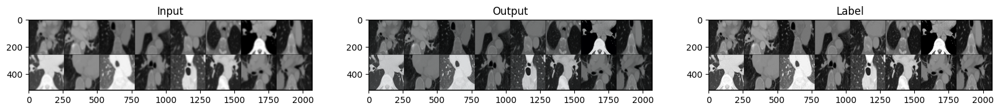

  3%|▎         | 1/39 [00:03<01:58,  3.12s/it]

Train Epoch: 13 [0/613 (0%)]	Loss: 3.204683


 79%|███████▉  | 31/39 [00:56<00:14,  1.79s/it]

Train Epoch: 13 [60/613 (77%)]	Loss: 3.335604


100%|██████████| 39/39 [01:09<00:00,  1.79s/it]


Mean loss on trainset: 124.68970489501953


  0%|          | 0/315 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


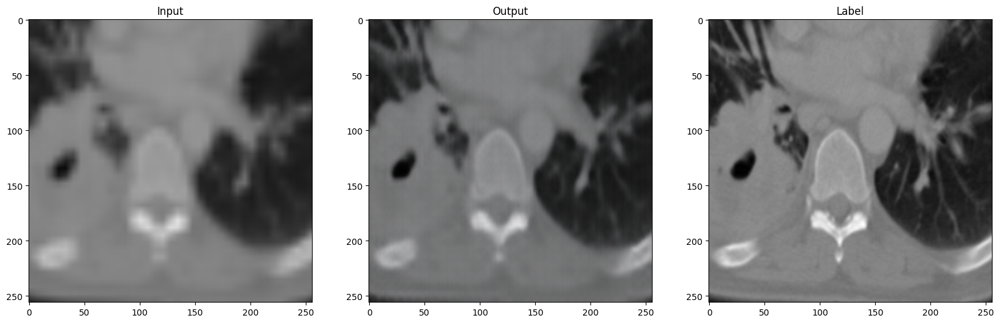

  0%|          | 1/315 [00:01<05:56,  1.14s/it]

Test Epoch: 13 [0/315 (0%)]	Loss: 3.687593


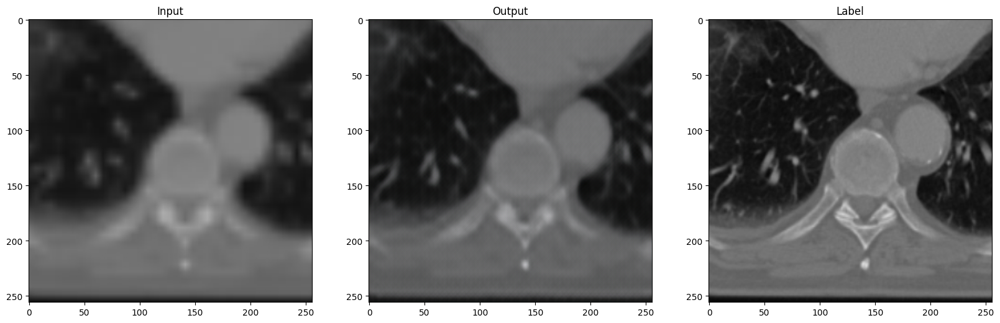

  1%|          | 2/315 [00:02<05:56,  1.14s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


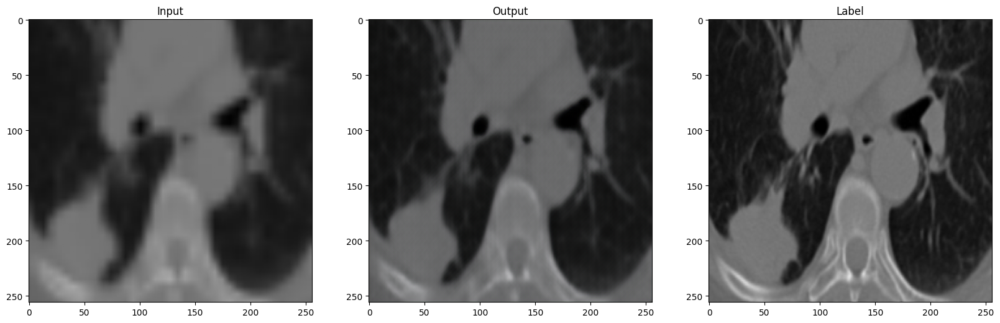

 11%|█         | 34/315 [00:04<00:13, 21.27it/s]

Test Epoch: 13 [60/315 (10%)]	Loss: 3.789915


 20%|██        | 64/315 [00:06<00:12, 19.93it/s]

Test Epoch: 13 [120/315 (19%)]	Loss: 4.096562


 30%|██▉       | 94/315 [00:07<00:10, 21.93it/s]

Test Epoch: 13 [180/315 (29%)]	Loss: 3.398714


 39%|███▉      | 124/315 [00:08<00:08, 23.34it/s]

Test Epoch: 13 [240/315 (38%)]	Loss: 3.041739


 49%|████▉     | 154/315 [00:09<00:06, 24.73it/s]

Test Epoch: 13 [300/315 (48%)]	Loss: 3.504612


 58%|█████▊    | 184/315 [00:11<00:05, 24.18it/s]

Test Epoch: 13 [360/315 (57%)]	Loss: 3.662950


 68%|██████▊   | 214/315 [00:12<00:04, 24.41it/s]

Test Epoch: 13 [420/315 (67%)]	Loss: 2.267292


 77%|███████▋  | 244/315 [00:13<00:02, 24.27it/s]

Test Epoch: 13 [480/315 (76%)]	Loss: 3.298963


 87%|████████▋ | 274/315 [00:14<00:02, 20.20it/s]

Test Epoch: 13 [540/315 (86%)]	Loss: 2.909877


 97%|█████████▋| 304/315 [00:16<00:00, 20.17it/s]

Test Epoch: 13 [600/315 (95%)]	Loss: 8.449204


100%|██████████| 315/315 [00:16<00:00, 18.66it/s]


Test loss: 1225.3172607421875
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


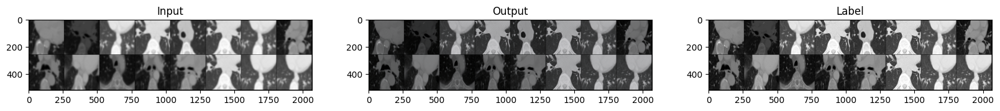

  3%|▎         | 1/39 [00:03<02:03,  3.25s/it]

Train Epoch: 14 [0/613 (0%)]	Loss: 3.060680


 79%|███████▉  | 31/39 [00:56<00:14,  1.78s/it]

Train Epoch: 14 [60/613 (77%)]	Loss: 3.066179


100%|██████████| 39/39 [01:10<00:00,  1.80s/it]


Mean loss on trainset: 123.31106734275818


  0%|          | 0/315 [00:00<?, ?it/s]

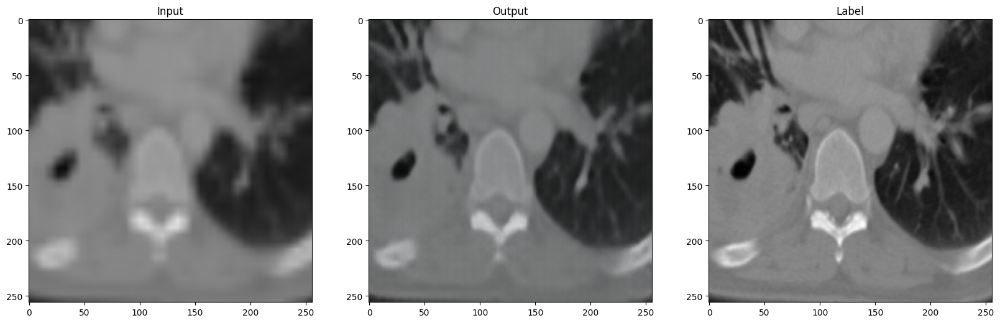

  0%|          | 1/315 [00:01<06:03,  1.16s/it]

Test Epoch: 14 [0/315 (0%)]	Loss: 3.680765


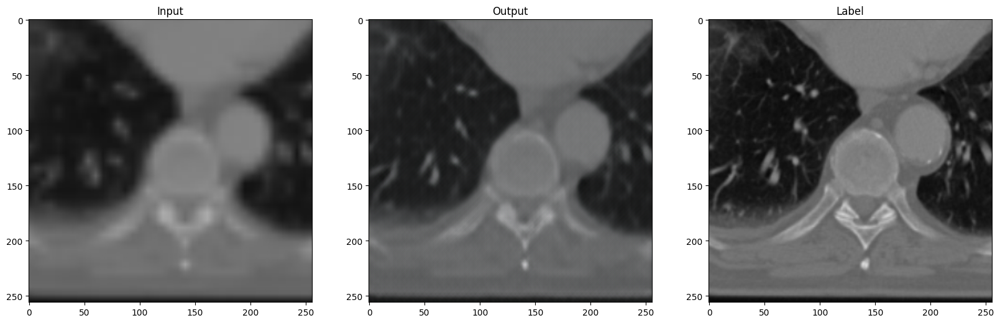

  1%|          | 2/315 [00:02<06:46,  1.30s/it]

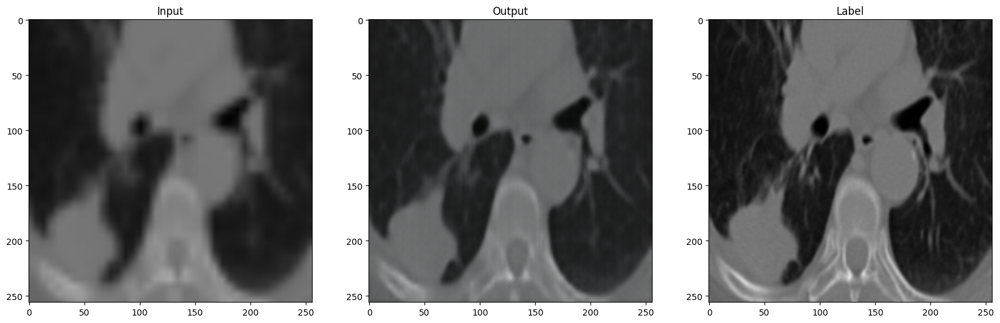

 11%|█         | 34/315 [00:05<00:13, 20.15it/s]

Test Epoch: 14 [60/315 (10%)]	Loss: 3.760849


 20%|██        | 64/315 [00:06<00:10, 23.66it/s]

Test Epoch: 14 [120/315 (19%)]	Loss: 4.054065


 30%|██▉       | 94/315 [00:07<00:09, 23.72it/s]

Test Epoch: 14 [180/315 (29%)]	Loss: 3.390341


 39%|███▉      | 124/315 [00:08<00:07, 24.24it/s]

Test Epoch: 14 [240/315 (38%)]	Loss: 3.005848


 49%|████▉     | 154/315 [00:10<00:06, 24.73it/s]

Test Epoch: 14 [300/315 (48%)]	Loss: 3.459813


 58%|█████▊    | 184/315 [00:11<00:05, 24.54it/s]

Test Epoch: 14 [360/315 (57%)]	Loss: 3.653030


 68%|██████▊   | 214/315 [00:12<00:04, 24.44it/s]

Test Epoch: 14 [420/315 (67%)]	Loss: 2.320179


 77%|███████▋  | 244/315 [00:13<00:03, 23.63it/s]

Test Epoch: 14 [480/315 (76%)]	Loss: 3.299807


 86%|████████▌ | 271/315 [00:14<00:02, 19.97it/s]

Test Epoch: 14 [540/315 (86%)]	Loss: 3.013258


 97%|█████████▋| 304/315 [00:16<00:00, 18.75it/s]

Test Epoch: 14 [600/315 (95%)]	Loss: 7.930208


100%|██████████| 315/315 [00:17<00:00, 18.20it/s]


Test loss: 1219.1068115234375
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


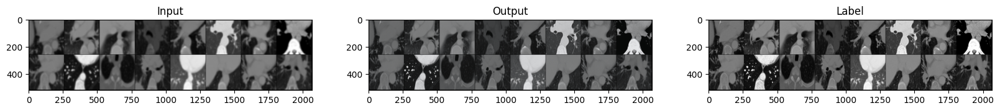

  3%|▎         | 1/39 [00:03<01:59,  3.15s/it]

Train Epoch: 15 [0/613 (0%)]	Loss: 2.699085


 79%|███████▉  | 31/39 [00:57<00:14,  1.77s/it]

Train Epoch: 15 [60/613 (77%)]	Loss: 3.238415


100%|██████████| 39/39 [01:10<00:00,  1.82s/it]


Mean loss on trainset: 118.30996513366699


  0%|          | 0/315 [00:00<?, ?it/s]

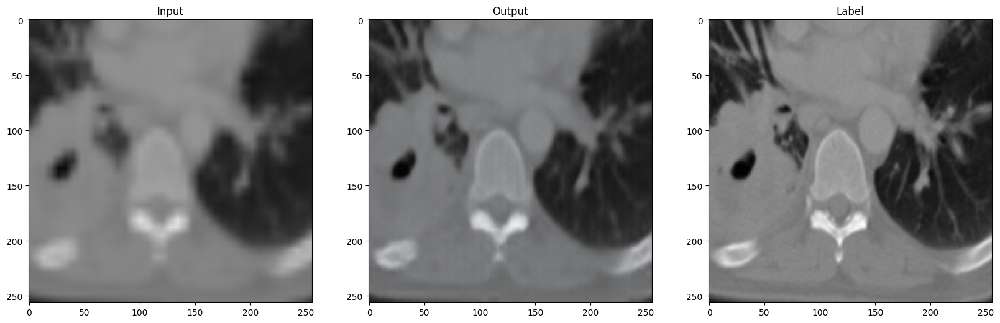

  0%|          | 1/315 [00:01<05:32,  1.06s/it]

Test Epoch: 15 [0/315 (0%)]	Loss: 3.623702


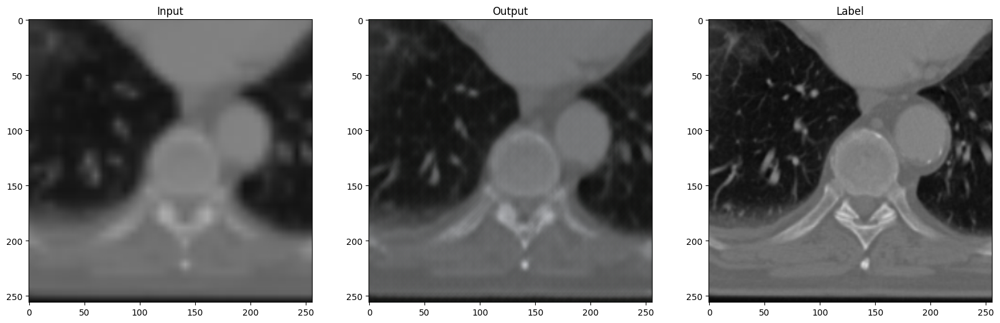

  1%|          | 2/315 [00:02<05:33,  1.07s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


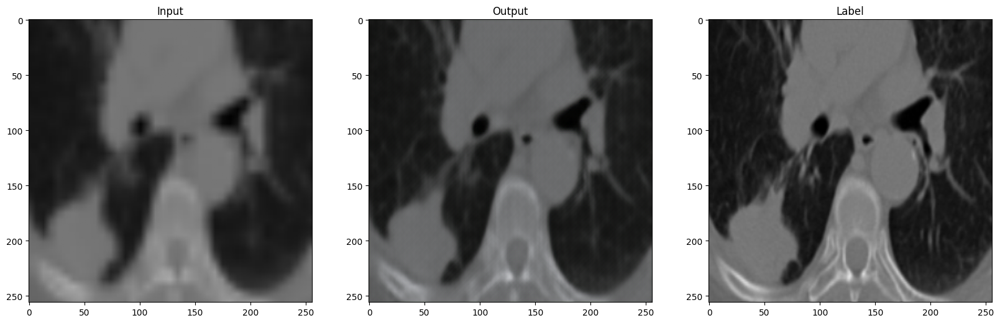

 11%|█▏        | 36/315 [00:04<00:12, 21.73it/s]

Test Epoch: 15 [60/315 (10%)]	Loss: 3.684291


 21%|██        | 66/315 [00:05<00:10, 24.73it/s]

Test Epoch: 15 [120/315 (19%)]	Loss: 4.025613


 30%|███       | 96/315 [00:06<00:08, 24.78it/s]

Test Epoch: 15 [180/315 (29%)]	Loss: 3.280257


 40%|████      | 126/315 [00:08<00:07, 24.42it/s]

Test Epoch: 15 [240/315 (38%)]	Loss: 2.951644


 49%|████▊     | 153/315 [00:09<00:07, 23.13it/s]

Test Epoch: 15 [300/315 (48%)]	Loss: 3.386347


 59%|█████▉    | 186/315 [00:10<00:05, 23.56it/s]

Test Epoch: 15 [360/315 (57%)]	Loss: 3.590912


 68%|██████▊   | 213/315 [00:11<00:04, 22.28it/s]

Test Epoch: 15 [420/315 (67%)]	Loss: 2.225855


 78%|███████▊  | 246/315 [00:13<00:03, 22.24it/s]

Test Epoch: 15 [480/315 (76%)]	Loss: 3.294054


 86%|████████▋ | 272/315 [00:14<00:02, 16.96it/s]

Test Epoch: 15 [540/315 (86%)]	Loss: 2.377470


 96%|█████████▌| 303/315 [00:16<00:00, 16.02it/s]

Test Epoch: 15 [600/315 (95%)]	Loss: 7.423654


100%|██████████| 315/315 [00:17<00:00, 18.19it/s]


Test loss: 1170.693359375
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


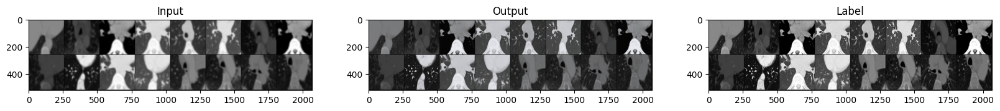

  3%|▎         | 1/39 [00:03<02:01,  3.21s/it]

Train Epoch: 16 [0/613 (0%)]	Loss: 3.096585


 79%|███████▉  | 31/39 [00:57<00:14,  1.81s/it]

Train Epoch: 16 [60/613 (77%)]	Loss: 2.950639


100%|██████████| 39/39 [01:10<00:00,  1.81s/it]


Mean loss on trainset: 115.7004086971283


  0%|          | 0/315 [00:00<?, ?it/s]

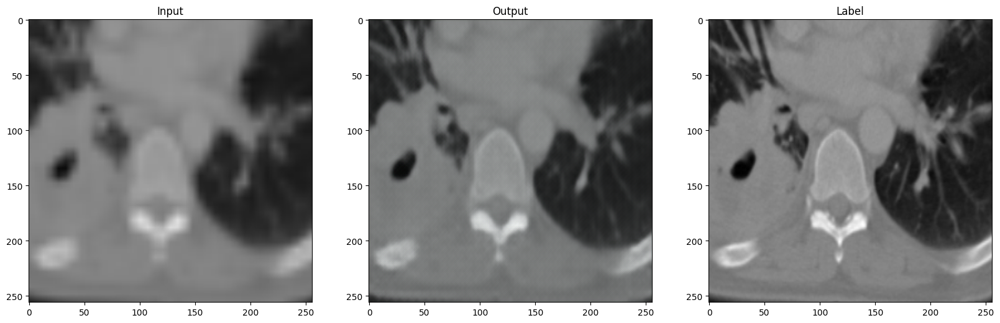

  0%|          | 1/315 [00:01<05:39,  1.08s/it]

Test Epoch: 16 [0/315 (0%)]	Loss: 3.655735


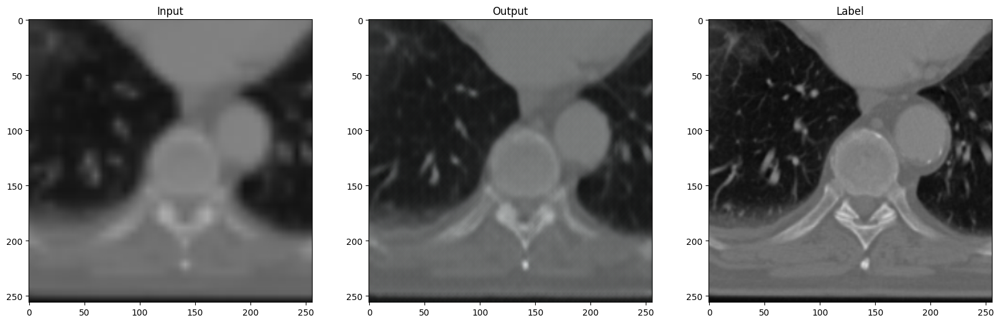

  1%|          | 2/315 [00:02<05:36,  1.08s/it]

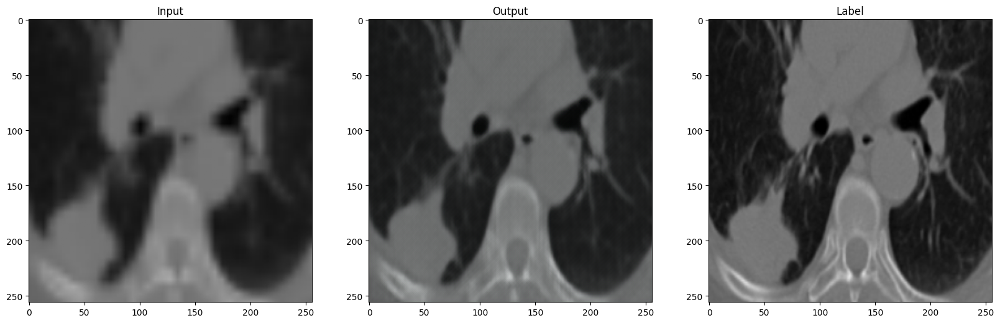

 11%|█         | 34/315 [00:04<00:14, 19.87it/s]

Test Epoch: 16 [60/315 (10%)]	Loss: 3.639663


 20%|██        | 64/315 [00:05<00:10, 24.38it/s]

Test Epoch: 16 [120/315 (19%)]	Loss: 3.980592


 30%|██▉       | 94/315 [00:07<00:09, 24.13it/s]

Test Epoch: 16 [180/315 (29%)]	Loss: 3.432803


 39%|███▉      | 124/315 [00:08<00:08, 21.81it/s]

Test Epoch: 16 [240/315 (38%)]	Loss: 3.062280


 49%|████▉     | 154/315 [00:09<00:06, 23.23it/s]

Test Epoch: 16 [300/315 (48%)]	Loss: 3.380348


 58%|█████▊    | 184/315 [00:10<00:05, 23.27it/s]

Test Epoch: 16 [360/315 (57%)]	Loss: 3.621412


 68%|██████▊   | 214/315 [00:12<00:05, 19.98it/s]

Test Epoch: 16 [420/315 (67%)]	Loss: 2.300423


 77%|███████▋  | 244/315 [00:13<00:03, 21.33it/s]

Test Epoch: 16 [480/315 (76%)]	Loss: 3.307227


 87%|████████▋ | 274/315 [00:15<00:02, 20.02it/s]

Test Epoch: 16 [540/315 (86%)]	Loss: 2.319271


 97%|█████████▋| 304/315 [00:16<00:00, 20.08it/s]

Test Epoch: 16 [600/315 (95%)]	Loss: 6.754345


100%|██████████| 315/315 [00:17<00:00, 18.42it/s]


Test loss: 1160.2493896484375
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


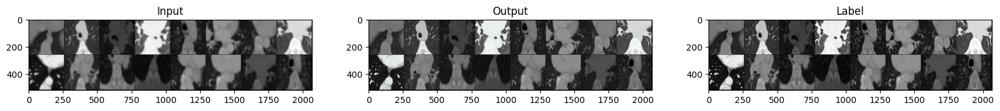

  3%|▎         | 1/39 [00:03<02:06,  3.32s/it]

Train Epoch: 17 [0/613 (0%)]	Loss: 2.949346


 79%|███████▉  | 31/39 [00:57<00:14,  1.79s/it]

Train Epoch: 17 [60/613 (77%)]	Loss: 2.999340


100%|██████████| 39/39 [01:10<00:00,  1.81s/it]


Mean loss on trainset: 111.28912234306335


  0%|          | 0/315 [00:00<?, ?it/s]

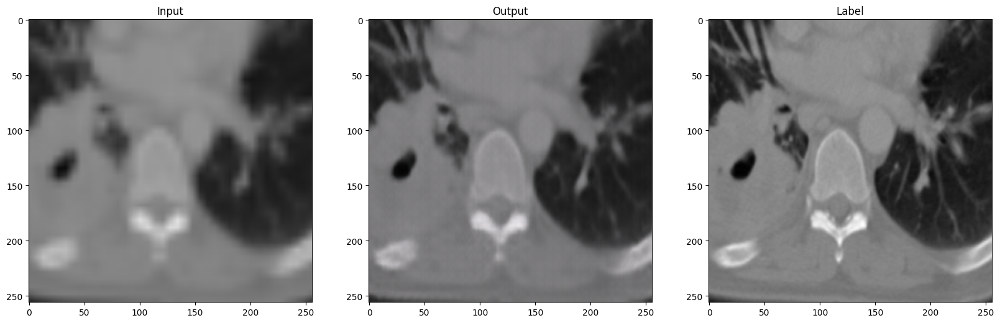

  0%|          | 1/315 [00:01<06:07,  1.17s/it]

Test Epoch: 17 [0/315 (0%)]	Loss: 3.602420


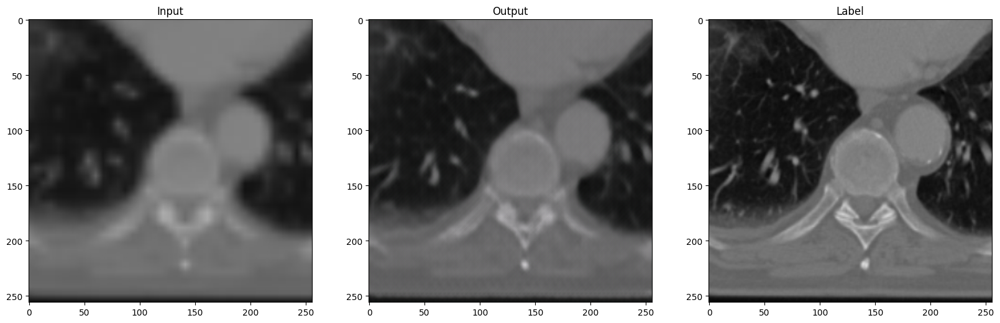

  1%|          | 2/315 [00:02<05:54,  1.13s/it]

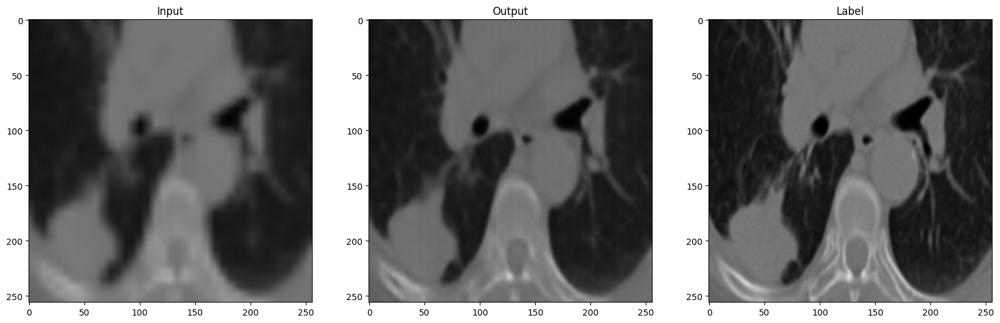

 11%|█         | 35/315 [00:04<00:13, 20.21it/s]

Test Epoch: 17 [60/315 (10%)]	Loss: 3.632869


 21%|██        | 65/315 [00:06<00:10, 24.12it/s]

Test Epoch: 17 [120/315 (19%)]	Loss: 4.031393


 29%|██▉       | 92/315 [00:07<00:11, 19.96it/s]

Test Epoch: 17 [180/315 (29%)]	Loss: 3.347774


 39%|███▉      | 124/315 [00:08<00:09, 21.00it/s]

Test Epoch: 17 [240/315 (38%)]	Loss: 2.986978


 50%|████▉     | 156/315 [00:10<00:06, 23.24it/s]

Test Epoch: 17 [300/315 (48%)]	Loss: 3.285450


 59%|█████▉    | 186/315 [00:11<00:05, 24.16it/s]

Test Epoch: 17 [360/315 (57%)]	Loss: 3.523009


 68%|██████▊   | 213/315 [00:12<00:04, 23.26it/s]

Test Epoch: 17 [420/315 (67%)]	Loss: 2.225178


 78%|███████▊  | 246/315 [00:14<00:02, 24.15it/s]

Test Epoch: 17 [480/315 (76%)]	Loss: 3.309269


 87%|████████▋ | 273/315 [00:15<00:02, 20.54it/s]

Test Epoch: 17 [540/315 (86%)]	Loss: 2.056217


 96%|█████████▌| 303/315 [00:16<00:00, 19.77it/s]

Test Epoch: 17 [600/315 (95%)]	Loss: 6.669016


100%|██████████| 315/315 [00:17<00:00, 18.22it/s]


Test loss: 1139.205078125
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


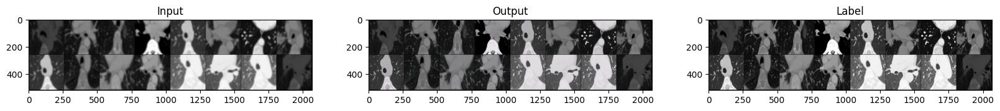

  3%|▎         | 1/39 [00:03<02:02,  3.22s/it]

Train Epoch: 18 [0/613 (0%)]	Loss: 3.149017


 79%|███████▉  | 31/39 [00:57<00:14,  1.77s/it]

Train Epoch: 18 [60/613 (77%)]	Loss: 3.118366


100%|██████████| 39/39 [01:10<00:00,  1.80s/it]


Mean loss on trainset: 111.54864454269409


  0%|          | 0/315 [00:00<?, ?it/s]

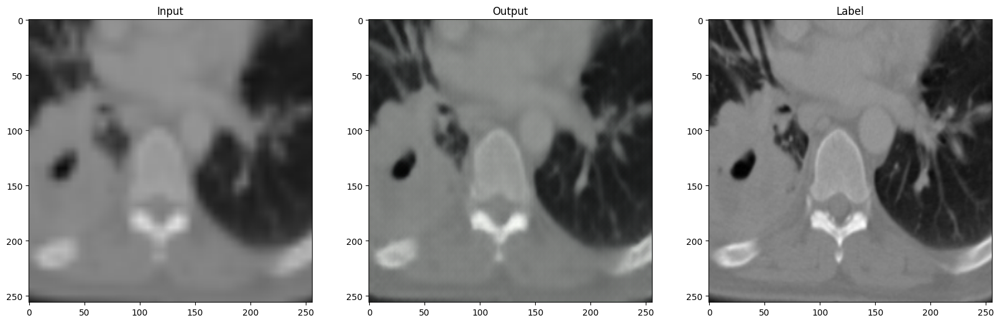

  0%|          | 1/315 [00:01<05:44,  1.10s/it]

Test Epoch: 18 [0/315 (0%)]	Loss: 3.708330


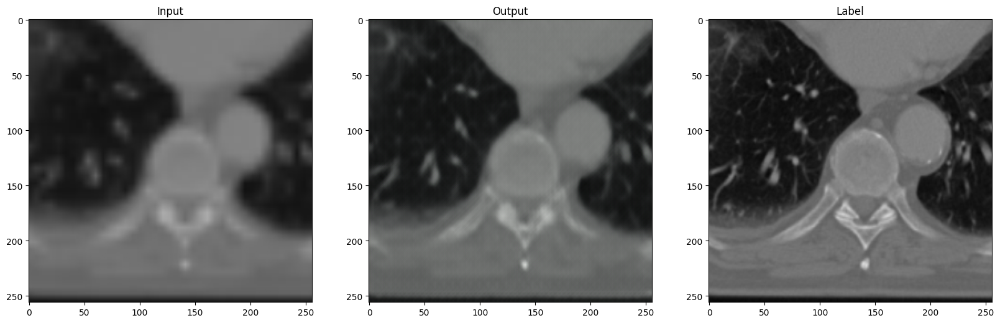

  1%|          | 2/315 [00:02<05:44,  1.10s/it]

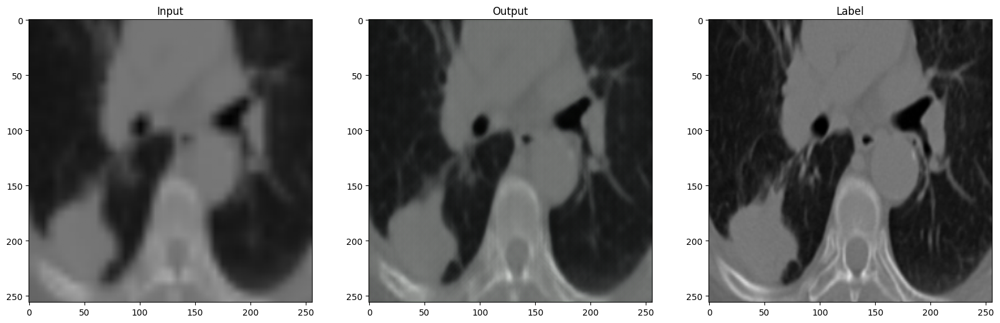

 10%|█         | 32/315 [00:04<00:14, 19.03it/s]

Test Epoch: 18 [60/315 (10%)]	Loss: 3.765471


 21%|██        | 65/315 [00:06<00:11, 21.52it/s]

Test Epoch: 18 [120/315 (19%)]	Loss: 4.153202


 30%|███       | 95/315 [00:07<00:09, 24.03it/s]

Test Epoch: 18 [180/315 (29%)]	Loss: 3.355592


 40%|███▉      | 125/315 [00:08<00:07, 23.97it/s]

Test Epoch: 18 [240/315 (38%)]	Loss: 3.076218


 49%|████▉     | 155/315 [00:09<00:06, 24.47it/s]

Test Epoch: 18 [300/315 (48%)]	Loss: 3.382694


 59%|█████▊    | 185/315 [00:11<00:05, 24.59it/s]

Test Epoch: 18 [360/315 (57%)]	Loss: 3.734607


 68%|██████▊   | 215/315 [00:12<00:04, 24.36it/s]

Test Epoch: 18 [420/315 (67%)]	Loss: 2.273172


 78%|███████▊  | 245/315 [00:13<00:02, 24.02it/s]

Test Epoch: 18 [480/315 (76%)]	Loss: 3.376186


 86%|████████▋ | 272/315 [00:14<00:02, 20.72it/s]

Test Epoch: 18 [540/315 (86%)]	Loss: 2.758440


 97%|█████████▋| 304/315 [00:16<00:00, 18.11it/s]

Test Epoch: 18 [600/315 (95%)]	Loss: 7.502317


100%|██████████| 315/315 [00:17<00:00, 18.49it/s]


Test loss: 1211.732666015625
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth
Learning rate : 0.001


  0%|          | 0/39 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


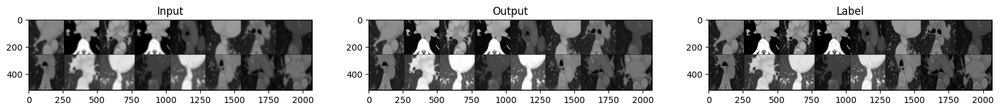

  3%|▎         | 1/39 [00:03<02:03,  3.26s/it]

Train Epoch: 19 [0/613 (0%)]	Loss: 2.283305


 79%|███████▉  | 31/39 [00:57<00:14,  1.78s/it]

Train Epoch: 19 [60/613 (77%)]	Loss: 2.870702


100%|██████████| 39/39 [01:10<00:00,  1.82s/it]


Mean loss on trainset: 107.89919185638428


  0%|          | 0/315 [00:00<?, ?it/s]

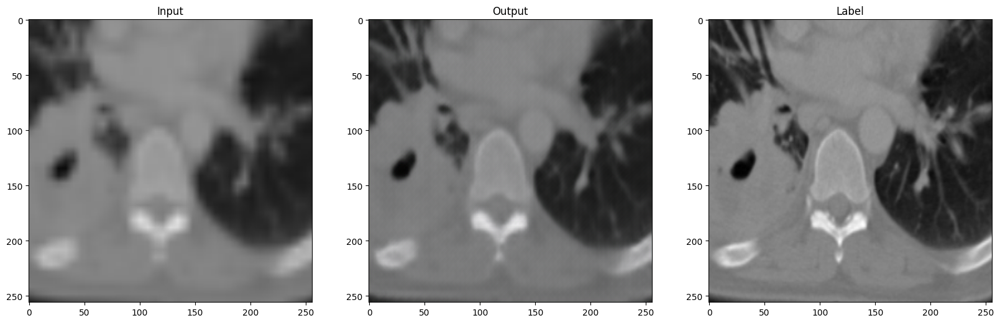

  0%|          | 1/315 [00:01<06:15,  1.19s/it]

Test Epoch: 19 [0/315 (0%)]	Loss: 3.547739


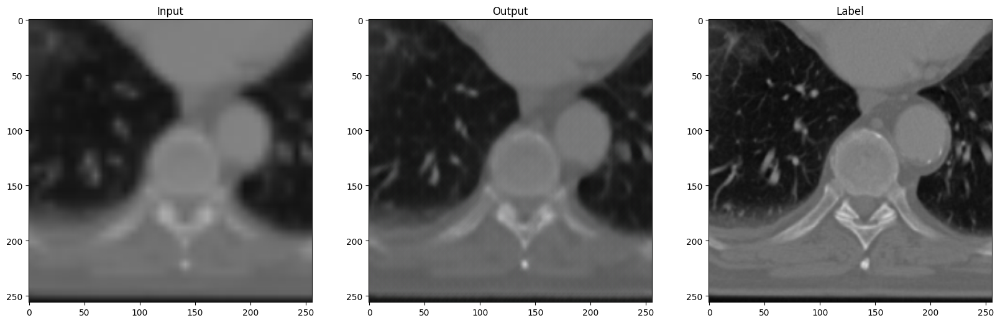

  1%|          | 2/315 [00:02<07:04,  1.36s/it]

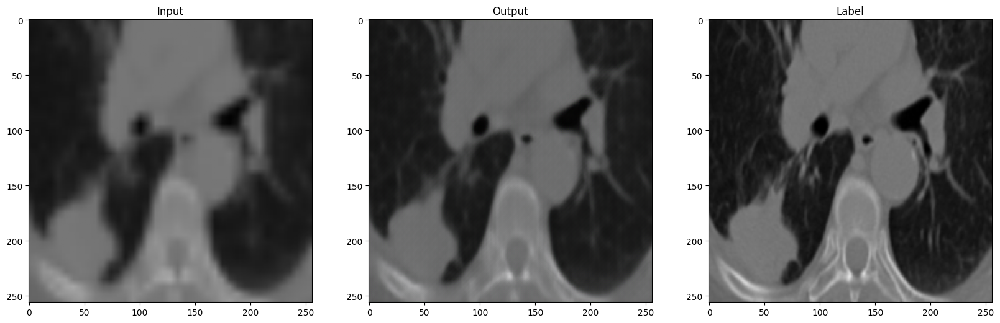

 11%|█         | 34/315 [00:04<00:13, 21.38it/s]

Test Epoch: 19 [60/315 (10%)]	Loss: 3.700479


 20%|██        | 64/315 [00:06<00:10, 24.27it/s]

Test Epoch: 19 [120/315 (19%)]	Loss: 4.027907


 30%|██▉       | 94/315 [00:07<00:09, 23.57it/s]

Test Epoch: 19 [180/315 (29%)]	Loss: 3.263692


 39%|███▉      | 124/315 [00:08<00:07, 24.11it/s]

Test Epoch: 19 [240/315 (38%)]	Loss: 2.887371


 49%|████▉     | 154/315 [00:09<00:06, 24.43it/s]

Test Epoch: 19 [300/315 (48%)]	Loss: 3.328236


 58%|█████▊    | 184/315 [00:11<00:05, 23.54it/s]

Test Epoch: 19 [360/315 (57%)]	Loss: 3.484643


 68%|██████▊   | 214/315 [00:12<00:04, 21.78it/s]

Test Epoch: 19 [420/315 (67%)]	Loss: 2.196026


 77%|███████▋  | 244/315 [00:13<00:03, 20.03it/s]

Test Epoch: 19 [480/315 (76%)]	Loss: 3.293366


 87%|████████▋ | 273/315 [00:15<00:02, 19.41it/s]

Test Epoch: 19 [540/315 (86%)]	Loss: 1.911656


 97%|█████████▋| 305/315 [00:16<00:00, 19.87it/s]

Test Epoch: 19 [600/315 (95%)]	Loss: 6.583198


100%|██████████| 315/315 [00:17<00:00, 18.06it/s]


Test loss: 1128.5489501953125
Saving best model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_best.pth
Saving current model at /content/drive/MyDrive/2023_CV/checkpoints/checkpoints_02122023_213927_current.pth


In [ ]:
# train
torch.cuda.empty_cache()
w = train(model, train_dataloader, test_dataloader, criterion, optimizer, scheduler, n_epochs=20, log_interval=30)

In [ ]:
 model

RUNet(
  (block1): InitialBlock(
    (layers): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
  )
  (block2): Sequential(
    (0): ResBlock(
      (layers): Sequential(
        (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
        (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (1): ResBlock(
      (layers): Sequential(
        (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
        (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1,

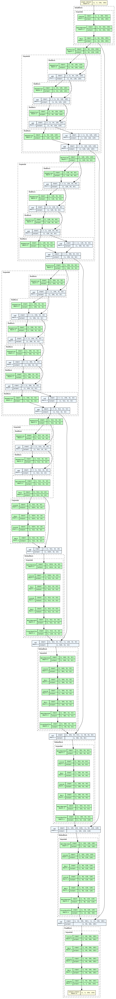

In [ ]:
#!pip install -q torchview
! pip install -q -U graphviz
from torchview import draw_graph
import graphviz

graphviz.set_jupyter_format('png')

model_graph = draw_graph(model, input_size=(1,3,256,256), expand_nested=True,
                         save_graph=False, filename='RUNet_graphic.png', directory=DATA_ROOT)
model_graph.visual_graph

In [ ]:
torch.cuda.memory_summary(device=None, abbreviated=False)


'|===========================================================================|\n|                  PyTorch CUDA memory summary, device ID 0                 |\n|---------------------------------------------------------------------------|\n|            CUDA OOMs: 9            |        cudaMalloc retries: 9         |\n|===========================================================================|\n|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |\n|---------------------------------------------------------------------------|\n| Allocated memory      |  13919 MiB |  13919 MiB |  29504 MiB |  15585 MiB |\n|       from large pool |  13871 MiB |  13871 MiB |  29455 MiB |  15583 MiB |\n|       from small pool |     47 MiB |     48 MiB |     49 MiB |      1 MiB |\n|---------------------------------------------------------------------------|\n| Active memory         |  13919 MiB |  13919 MiB |  29504 MiB |  15585 MiB |\n|       from large pool |  13871 MiB |  13871 MiB |

In [ ]:
def visualize_sample(sample):
    image, label = sample['image'], sample['label']

    # Assuming image is a numpy array, transpose it from (C, H, W) to (H, W, C) for visualization
    if isinstance(image, np.ndarray) and image.ndim == 3 and image.shape[0] == 3:
        print('yes1')
        image = np.transpose(image, (1, 2, 0))

    # Normalize the image for matplotlib if needed
    if image.min() < 0 or image.max() > 1:
        print('yes2')
        image = (image - image.min()) / (image.max() - image.min())

    plt.imshow(image)
    plt.title("Image and Label")
    plt.show()


/content/drive/MyDrive/CTScan_dataset/Data/train/Adenocarcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Large cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Squamous cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Normal
Number of images found: 418
/content/drive/MyDrive/CTScan_dataset/Data/test/Adenocarcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Large cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Squamous cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Normal
Number of images found: 195
Loading RUNet weights from checkpoints/checkpoints_22112023_191747_best.pth


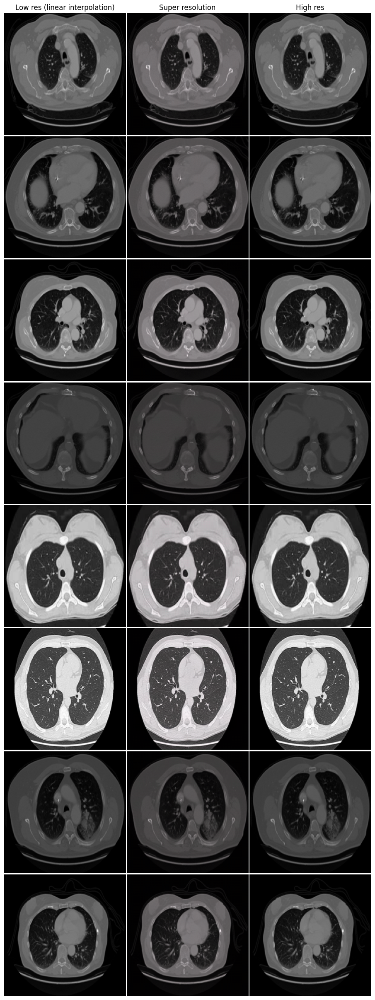

In [ ]:
from runet.visualize import RUNetVisualizer

checkpoint_unet = "checkpoints/checkpoints_22112023_191747_best.pth"

visualizer_runet = RUNetVisualizer()
visualizer_runet.visualize_runet(checkpoint_unet, batch_size=8)

In [ ]:
from runet.evaluate import RUNetEvaluation

checkpoint_unet = "checkpoints/checkpoints_22112023_191747_best.pth"
evaluator_runet = RUNetEvaluation()
evaluator_runet.evaluate(checkpoint_unet)

/content/drive/MyDrive/CTScan_dataset/Data/train/Adenocarcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Large cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Squamous cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Normal
Number of images found: 418
/content/drive/MyDrive/CTScan_dataset/Data/test/Adenocarcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Large cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Squamous cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Normal
Number of images found: 195
Loading RUNet weights from checkpoints/checkpoints_22112023_191747_best.pth


100%|██████████| 195/195 [00:09<00:00, 20.07it/s]

Mean PSNR of 38.642 on test set with std of 4.232
Mean SSIM of 0.99851 on test set with std of 0.00130
Mean MSE of 0.0002568 on test set with std of 0.0003777
Mean VGG-Perceptual of 0.15616 on test set with std of 0.10296


In [ ]:
!cd /content/drive/MyDrive/Colab_Notebooks/Github

In [ ]:
!git clone https://github.com/euijae/nyu_computer_vision_project

Cloning into 'nyu_computer_vision_project'...
fatal: could not read Username for 'https://github.com': No such device or address
